<a href="https://colab.research.google.com/github/Hari25483/Point-Clouds/blob/main/SUTD/Deep%20Learning%20with%20mmWave/DBSCAN_for_pointclouds_in_Python_with_Scikit_Learn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import matplotlib.pyplot as plt
import numpy as np

import pandas as pd

# Load the CSV file into a pandas DataFrame
df = pd.read_csv('/content/mmwave.csv')

# Sort the DataFrame based on 'FileName' in ascending order
df= df.sort_values(by='FileName', ascending=True)

# Save the sorted DataFrame to a new CSV file if needed
df.to_csv('/content/mmwave_sorted.csv', index=False)

df

,FileName,FileContent
35,combined_pointcloud_0000.txt,1.0379453897476196 -0.06593424081802368 0.1767...
44,combined_pointcloud_0001.txt,1.0361911058425903 -0.06593424081802368 0.1867...
60,combined_pointcloud_0002.txt,1.0392825603485107 -0.06593424081802368 0.1686...
51,combined_pointcloud_0003.txt,1.0518218278884888 0.06593424081802368 0.04731...
27,combined_pointcloud_0004.txt,1.1421900987625122 -0.0 0.0391288660466671\n1....
...,...,...
108,combined_pointcloud_0301.txt,0.9898008704185486 0.06318698078393936 0.19597...
127,combined_pointcloud_0302.txt,1.0425841808319092 -0.06593424081802368 0.1469...
128,combined_pointcloud_0303.txt,1.0884469747543335 -0.034340750426054 0.147288...
90,combined_pointcloud_0304.txt,1.0057262182235718 -0.06318698078393936 0.0814...


In [3]:
df.dropna(inplace=True)
df

,FileName,FileContent
35,combined_pointcloud_0000.txt,1.0379453897476196 -0.06593424081802368 0.1767...
44,combined_pointcloud_0001.txt,1.0361911058425903 -0.06593424081802368 0.1867...
60,combined_pointcloud_0002.txt,1.0392825603485107 -0.06593424081802368 0.1686...
51,combined_pointcloud_0003.txt,1.0518218278884888 0.06593424081802368 0.04731...
27,combined_pointcloud_0004.txt,1.1421900987625122 -0.0 0.0391288660466671\n1....
...,...,...
108,combined_pointcloud_0301.txt,0.9898008704185486 0.06318698078393936 0.19597...
127,combined_pointcloud_0302.txt,1.0425841808319092 -0.06593424081802368 0.1469...
128,combined_pointcloud_0303.txt,1.0884469747543335 -0.034340750426054 0.147288...
90,combined_pointcloud_0304.txt,1.0057262182235718 -0.06318698078393936 0.0814...


In [4]:
point_clouds = df['FileContent']
# Initialize a list to store all points
all_points = []

# Process each point cloud
for cloud_string in point_clouds:
    # print(cloud_string)
    # Split the string into lines, each line is a point
    points = cloud_string.split('\n')
    for po in points:
      point_value=po.split(' ')
      point_floats = [float(value) for value in point_value]
      # print(point_floats)
    all_points.append(list(map(float, point_floats)))

print(all_points)


[[1.5284843444824219, -0.0961541011929512, 0.14617224037647247], [1.081254482269287, -0.1030222475528717, 0.16692890226840973], [0.9725673794746399, 1.2362669706344604, 0.1726708710193634], [0.7872199416160583, 1.4230806827545166, -0.015205570496618748], [0.8285754323005676, 1.5000039339065552, 0.04734862595796585], [0.7997447848320007, 0.3750009834766388, 1.4692084789276123], [1.526404857635498, -0.1442311555147171, -0.12712904810905457], [1.8233603239059448, -0.2884623110294342, -0.021185558289289474], [1.8499130010604858, -0.3543965518474579, -0.15735046565532684], [1.6233503818511963, -0.05082431063055992, -0.08518023043870926], [0.4706973433494568, 2.0013787746429443, 0.20256486535072327], [1.863771677017212, 0.2472534030675888, -0.6146644949913025], [1.8641579151153564, 0.23626436293125153, 0.2040313184261322], [1.9087632894515991, 0.302198588848114, 0.07700248807668686], [0.9895505905151367, 0.2637369632720947, 1.8446929454803467], [1.8372067213058472, 0.40384724736213684, -1.04

In [5]:
print(len(all_points))

306


In [6]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Convert the list of points into a numpy array
X = np.array(all_points)
X2= StandardScaler().fit_transform(X)
# Now you can run DBSCAN
dbscan_cluster_model = DBSCAN(eps=0.2, min_samples=15).fit(X2)
dbscan_cluster_model

DBSCAN(eps=0.2, min_samples=15)

In [7]:
df['cluster'] = dbscan_cluster_model.labels_

df['cluster'].unique()

array([-1])

In [8]:
df

,FileName,FileContent,cluster
35,combined_pointcloud_0000.txt,1.0379453897476196 -0.06593424081802368 0.1767...,-1
44,combined_pointcloud_0001.txt,1.0361911058425903 -0.06593424081802368 0.1867...,-1
60,combined_pointcloud_0002.txt,1.0392825603485107 -0.06593424081802368 0.1686...,-1
51,combined_pointcloud_0003.txt,1.0518218278884888 0.06593424081802368 0.04731...,-1
27,combined_pointcloud_0004.txt,1.1421900987625122 -0.0 0.0391288660466671\n1....,-1
...,...,...,...
108,combined_pointcloud_0301.txt,0.9898008704185486 0.06318698078393936 0.19597...,-1
127,combined_pointcloud_0302.txt,1.0425841808319092 -0.06593424081802368 0.1469...,-1
128,combined_pointcloud_0303.txt,1.0884469747543335 -0.034340750426054 0.147288...,-1
90,combined_pointcloud_0304.txt,1.0057262182235718 -0.06318698078393936 0.0814...,-1


In [10]:
df['cluster'].value_counts()

-1    306
Name: cluster, dtype: int64

In [11]:
# import plotly.express as px

# fig = px.scatter(x=longg, y=lat, color=df['cluster'])

# fig.show()

In [12]:
from sklearn.metrics import silhouette_score as ss

ss(X2, df['cluster'])

ValueError: ignored

In [19]:
epsilons = np.linspace(0.01, 1, num=15)
epsilons

array([0.01      , 0.08071429, 0.15142857, 0.22214286, 0.29285714,
       0.36357143, 0.43428571, 0.505     , 0.57571429, 0.64642857,
       0.71714286, 0.78785714, 0.85857143, 0.92928571, 1.        ])

In [20]:
min_samples = np.arange(2, 20, step=3)
min_samples

array([ 2,  5,  8, 11, 14, 17])

In [21]:
import itertools

combinations = list(itertools.product(epsilons, min_samples))
combinations

[(0.01, 2),
 (0.01, 5),
 (0.01, 8),
 (0.01, 11),
 (0.01, 14),
 (0.01, 17),
 (0.08071428571428571, 2),
 (0.08071428571428571, 5),
 (0.08071428571428571, 8),
 (0.08071428571428571, 11),
 (0.08071428571428571, 14),
 (0.08071428571428571, 17),
 (0.15142857142857144, 2),
 (0.15142857142857144, 5),
 (0.15142857142857144, 8),
 (0.15142857142857144, 11),
 (0.15142857142857144, 14),
 (0.15142857142857144, 17),
 (0.22214285714285714, 2),
 (0.22214285714285714, 5),
 (0.22214285714285714, 8),
 (0.22214285714285714, 11),
 (0.22214285714285714, 14),
 (0.22214285714285714, 17),
 (0.29285714285714287, 2),
 (0.29285714285714287, 5),
 (0.29285714285714287, 8),
 (0.29285714285714287, 11),
 (0.29285714285714287, 14),
 (0.29285714285714287, 17),
 (0.3635714285714286, 2),
 (0.3635714285714286, 5),
 (0.3635714285714286, 8),
 (0.3635714285714286, 11),
 (0.3635714285714286, 14),
 (0.3635714285714286, 17),
 (0.4342857142857143, 2),
 (0.4342857142857143, 5),
 (0.4342857142857143, 8),
 (0.4342857142857143, 11),
 

In [22]:
N = len(combinations)
N

90

In [23]:
def get_scores_and_labels(combinations, X):
  scores = []
  all_labels_list = []

  for i, (eps, num_samples) in enumerate(combinations):
    dbscan_cluster_model = DBSCAN(eps=eps, min_samples=num_samples).fit(X)
    labels = dbscan_cluster_model.labels_
    labels_set = set(labels)
    num_clusters = len(labels_set)
    if -1 in labels_set:
      num_clusters -= 1

    if (num_clusters < 2) or (num_clusters > 3):
      scores.append(-10)
      all_labels_list.append('bad')
      c = (eps, num_samples)
      print(f"Combination {c} on iteration {i+1} of {N} has {num_clusters} clusters. Moving on")
      continue

    scores.append(ss(X, labels))
    all_labels_list.append(labels)
    print(f"Index: {i}, Score: {scores[-1]}, Labels: {all_labels_list[-1]}, NumClusters: {num_clusters}")

  best_index = np.argmax(scores)
  best_parameters = combinations[best_index]
  best_labels = all_labels_list[best_index]
  best_score = scores[best_index]

  return {'best_epsilon': best_parameters[0],
          'best_min_samples': best_parameters[1],
          'best_labels': best_labels,
          'best_score': best_score}

best_dict = get_scores_and_labels(combinations, X2)

Combination (0.01, 2) on iteration 1 of 90 has 0 clusters. Moving on
Combination (0.01, 5) on iteration 2 of 90 has 0 clusters. Moving on
Combination (0.01, 8) on iteration 3 of 90 has 0 clusters. Moving on
Combination (0.01, 11) on iteration 4 of 90 has 0 clusters. Moving on
Combination (0.01, 14) on iteration 5 of 90 has 0 clusters. Moving on
Combination (0.01, 17) on iteration 6 of 90 has 0 clusters. Moving on
Combination (0.08071428571428571, 2) on iteration 7 of 90 has 22 clusters. Moving on
Combination (0.08071428571428571, 5) on iteration 8 of 90 has 0 clusters. Moving on
Combination (0.08071428571428571, 8) on iteration 9 of 90 has 0 clusters. Moving on
Combination (0.08071428571428571, 11) on iteration 10 of 90 has 0 clusters. Moving on
Combination (0.08071428571428571, 14) on iteration 11 of 90 has 0 clusters. Moving on
Combination (0.08071428571428571, 17) on iteration 12 of 90 has 0 clusters. Moving on
Combination (0.15142857142857144, 2) on iteration 13 of 90 has 33 cluste

In [24]:
best_dict

{'best_epsilon': 0.505,
 'best_min_samples': 5,
 'best_labels': array([ 0,  0,  0,  0,  0, -1,  0,  0,  0,  0, -1,  0,  0,  0, -1, -1, -1,
         0, -1,  0,  0,  0, -1,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0, -1,
        -1,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        -1,  0,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0, -1,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,  0, -1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0, -1,  0,  0,  0, -1,
         0,  0,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0, -1, -1, -1,  0,  0,
        -1,  0,  0,  0,  0,  0,  0,  1,  0,  1,  0,  0, -1,  0,  0,  0,  0,
         0,  0,  0,  0,  

In [25]:
df['cluster'] = best_dict['best_labels']

df['cluster'].value_counts()

 0    256
-1     45
 1      5
Name: cluster, dtype: int64

In [26]:
df

,FileName,FileContent,cluster
35,combined_pointcloud_0000.txt,1.0379453897476196 -0.06593424081802368 0.1767...,0
44,combined_pointcloud_0001.txt,1.0361911058425903 -0.06593424081802368 0.1867...,0
60,combined_pointcloud_0002.txt,1.0392825603485107 -0.06593424081802368 0.1686...,0
51,combined_pointcloud_0003.txt,1.0518218278884888 0.06593424081802368 0.04731...,0
27,combined_pointcloud_0004.txt,1.1421900987625122 -0.0 0.0391288660466671\n1....,0
...,...,...,...
108,combined_pointcloud_0301.txt,0.9898008704185486 0.06318698078393936 0.19597...,0
127,combined_pointcloud_0302.txt,1.0425841808319092 -0.06593424081802368 0.1469...,0
128,combined_pointcloud_0303.txt,1.0884469747543335 -0.034340750426054 0.147288...,0
90,combined_pointcloud_0304.txt,1.0057262182235718 -0.06318698078393936 0.0814...,0


### Plot clusters in combined pointcloud_files

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


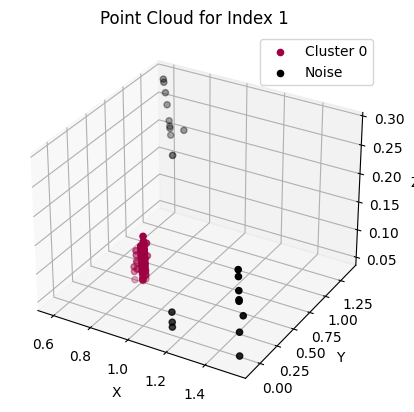

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


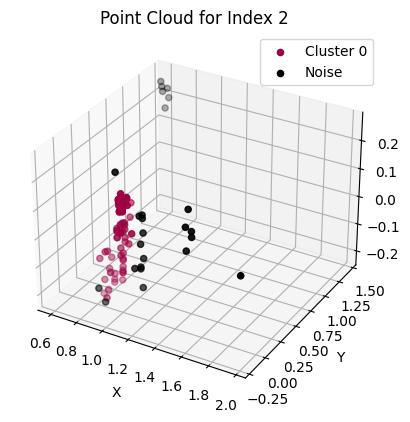

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


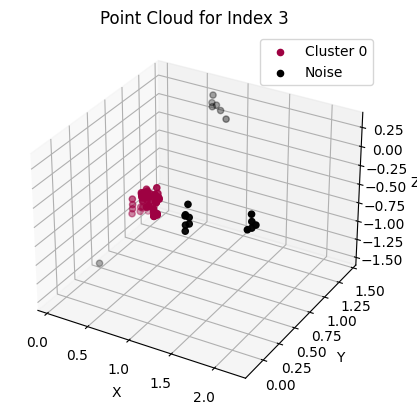

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


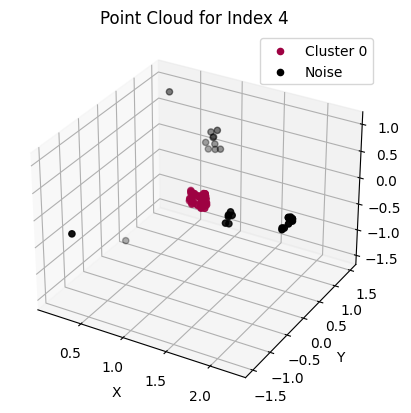

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


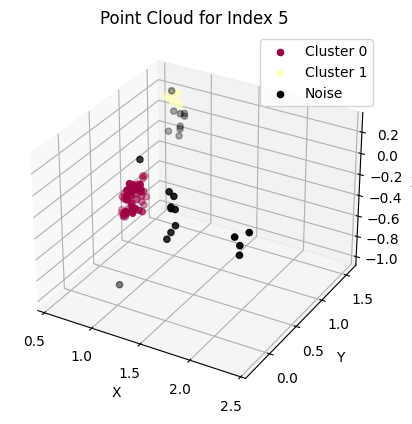

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


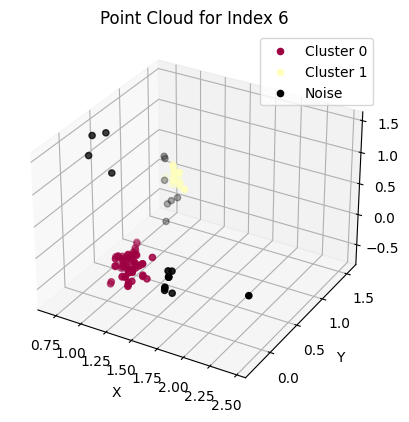

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


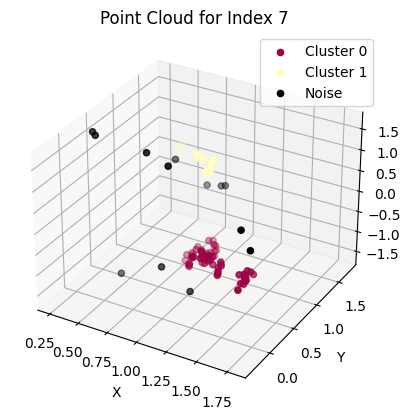

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


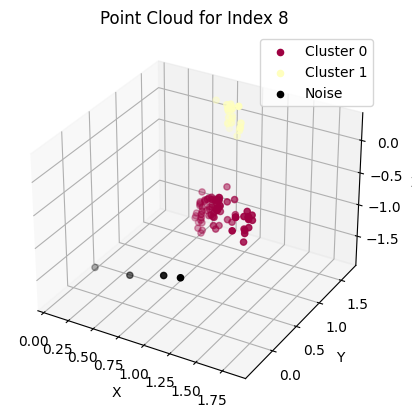

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


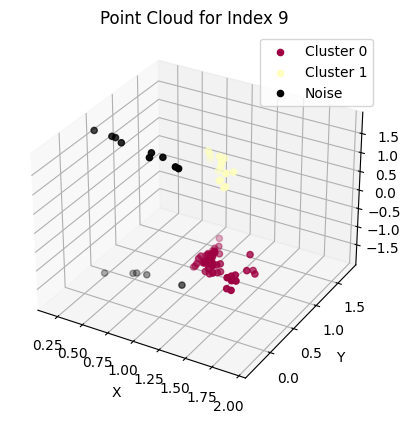

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


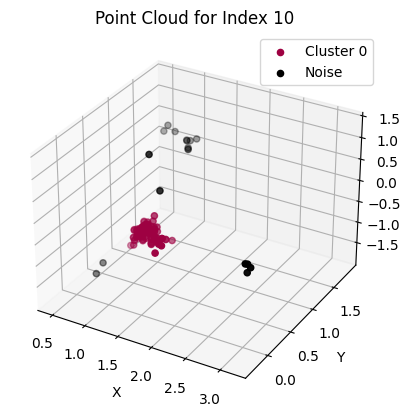

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


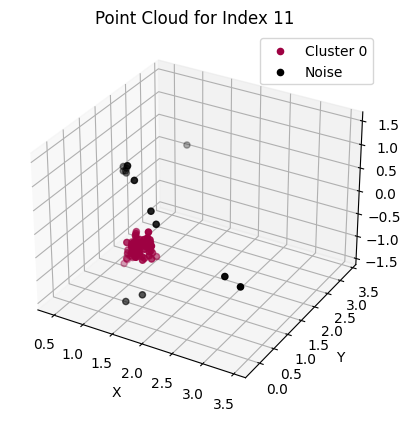

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


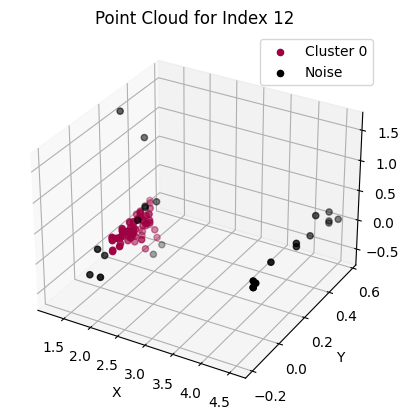

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


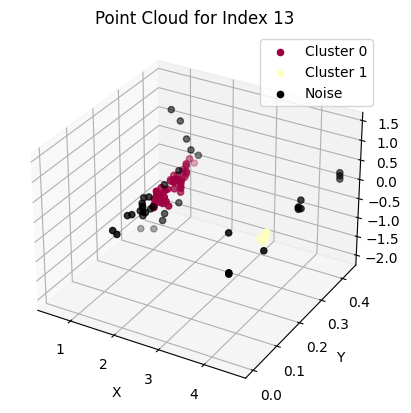

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


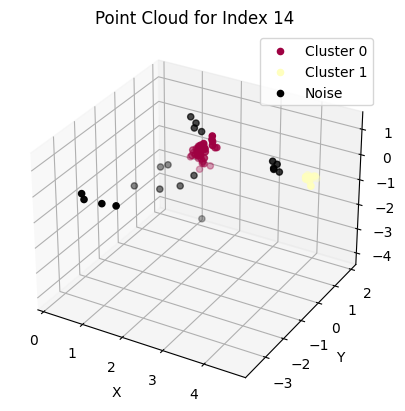

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


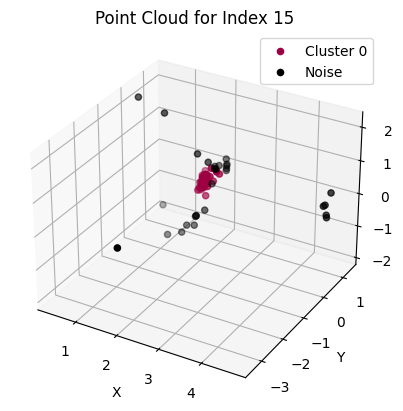

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


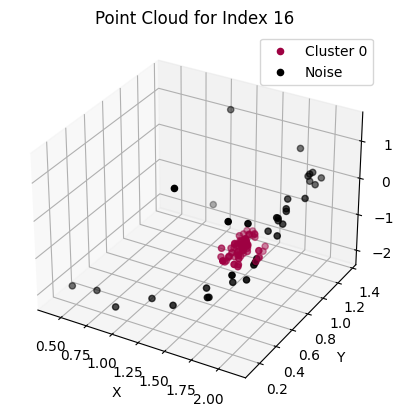

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


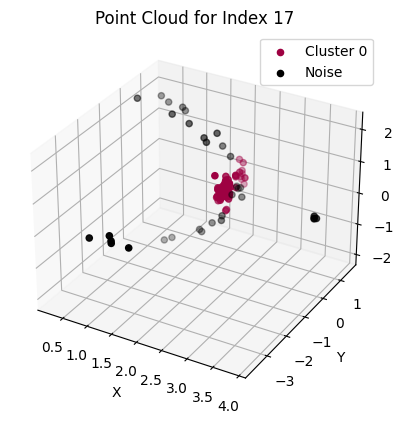

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


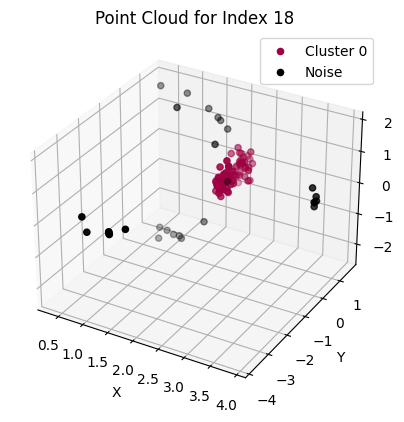

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


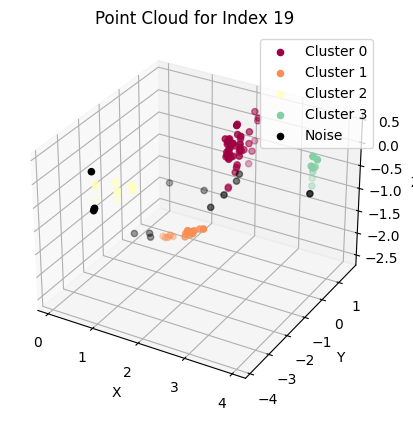

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


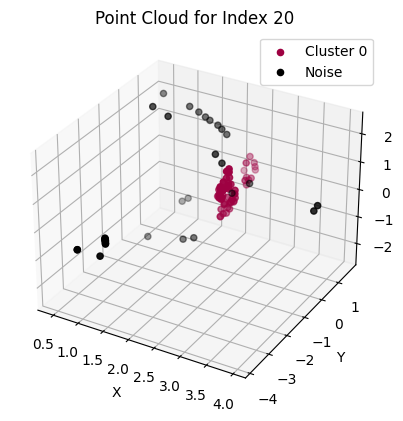

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


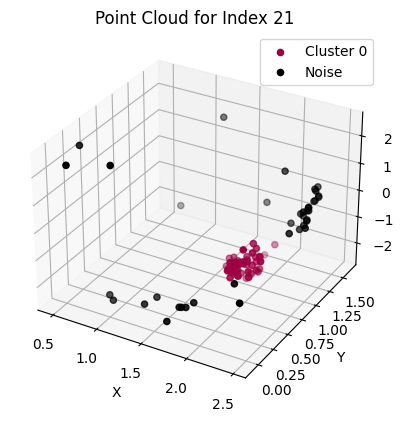

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


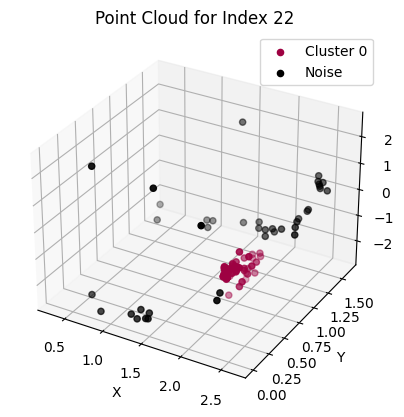

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


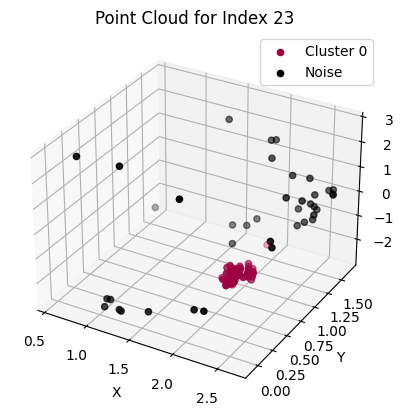

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


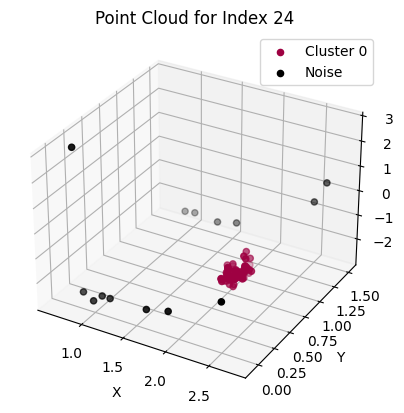

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


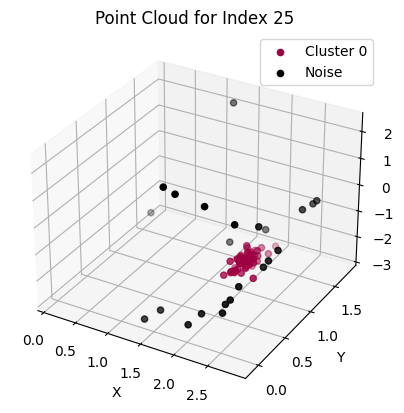

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


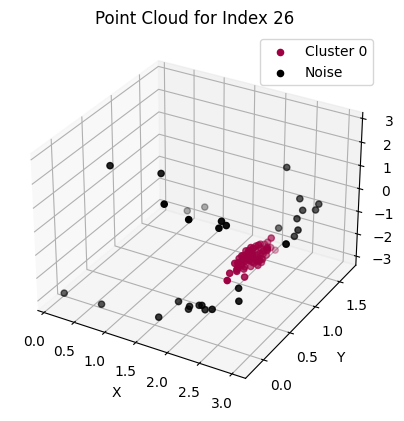

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


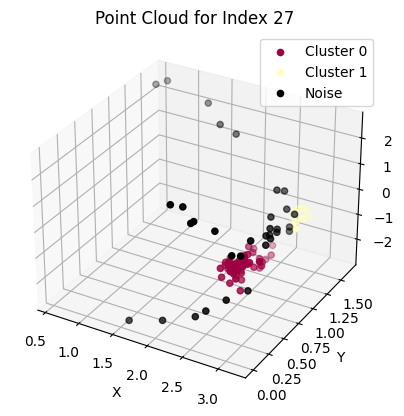

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


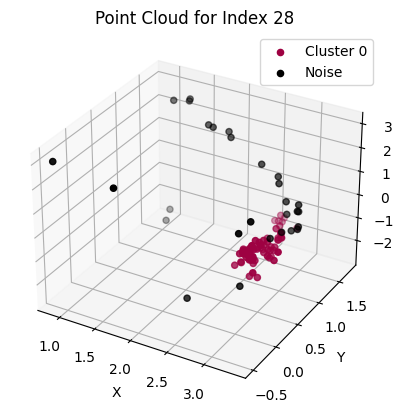

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


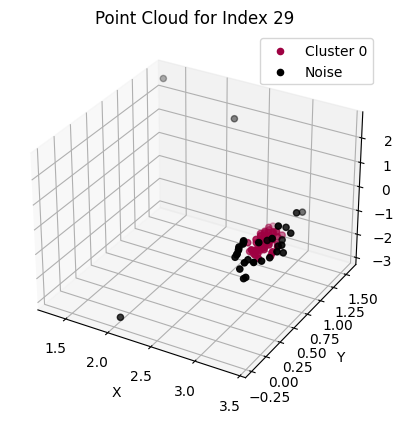

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


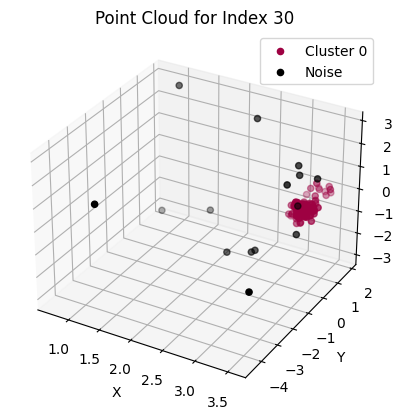

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


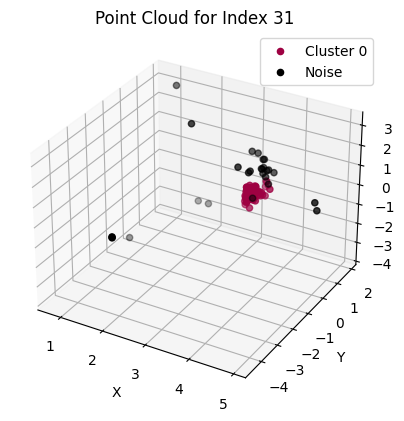

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


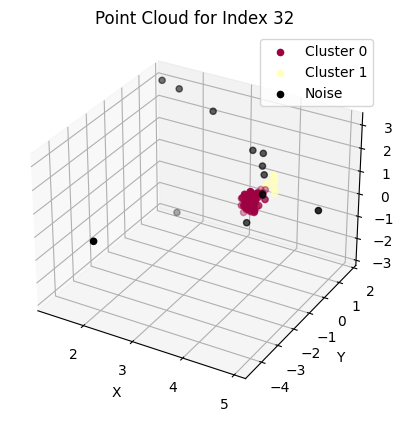

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


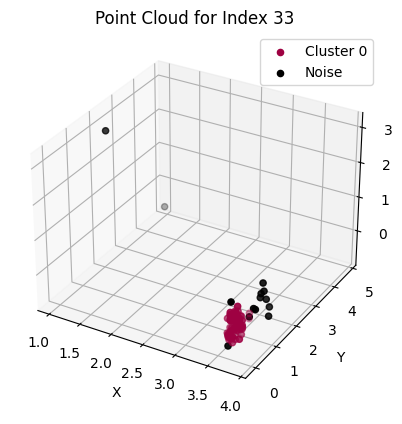

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


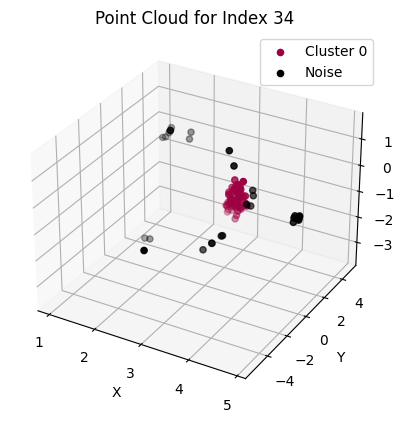

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


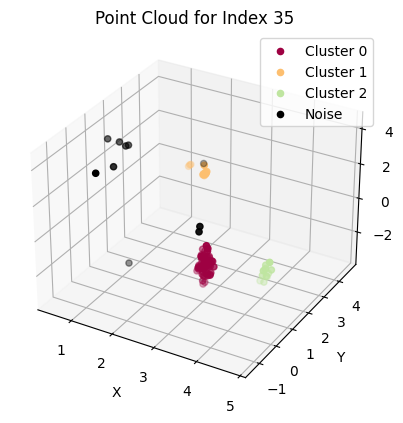

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


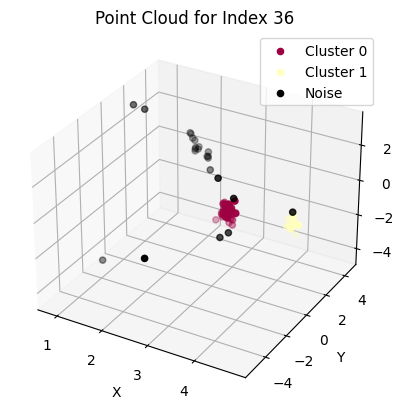

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


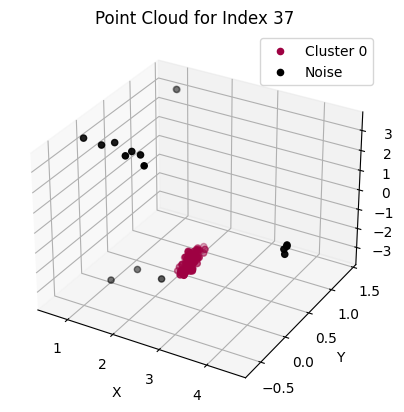

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


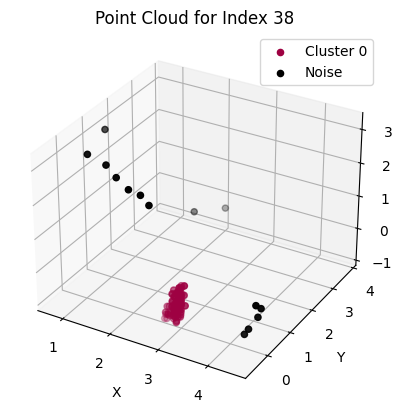

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


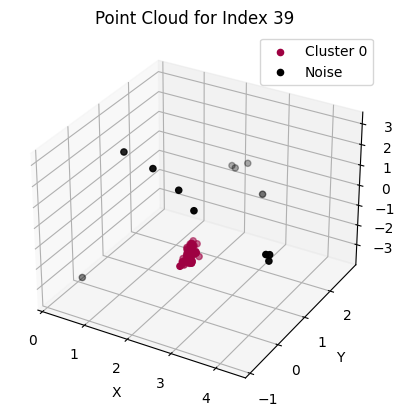

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


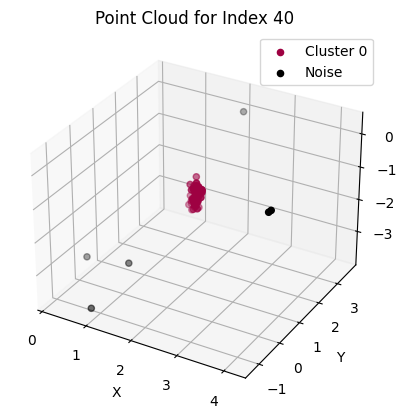

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


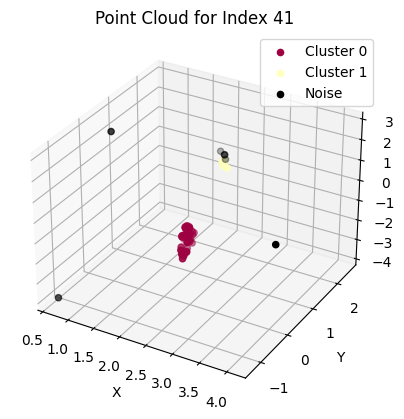

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


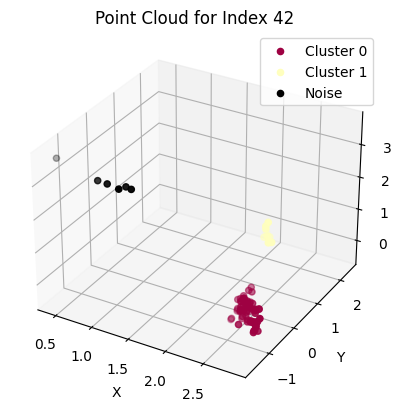

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


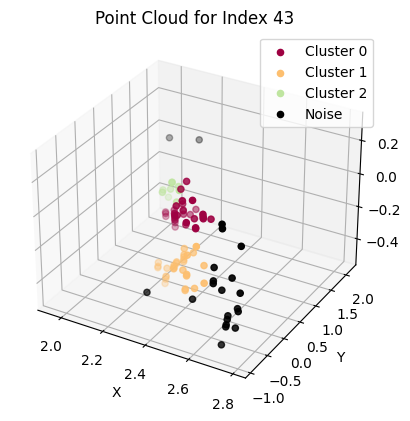

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


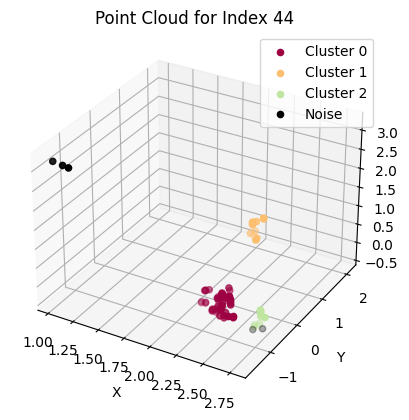

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


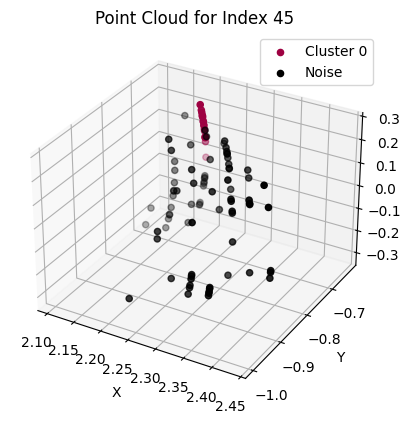

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


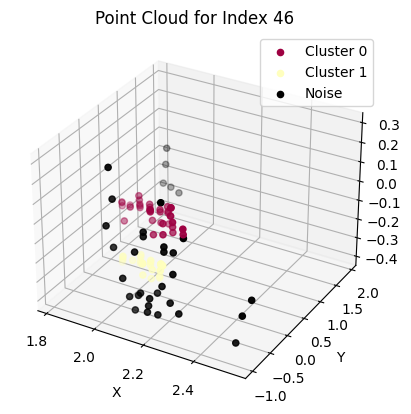

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


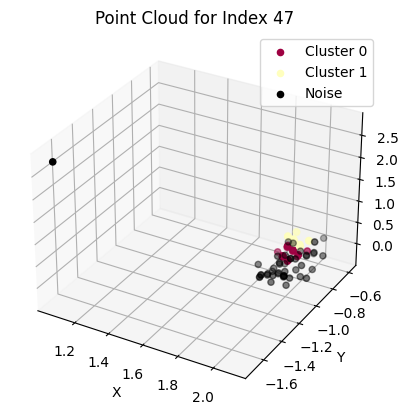

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


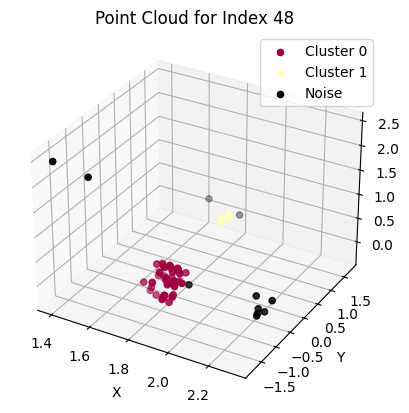

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


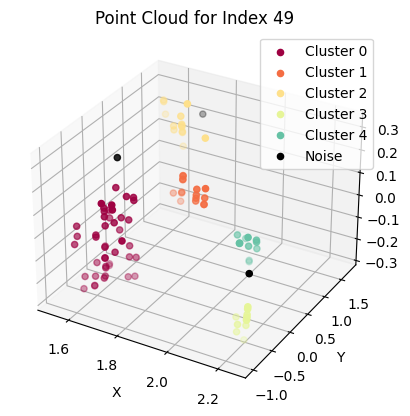

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


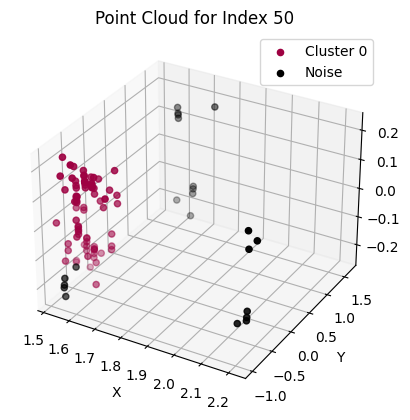

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


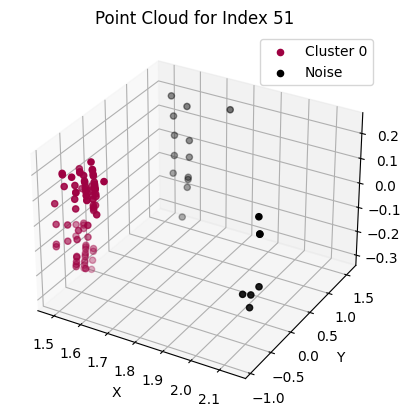

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


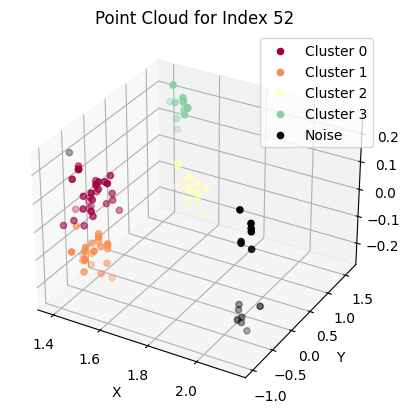

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


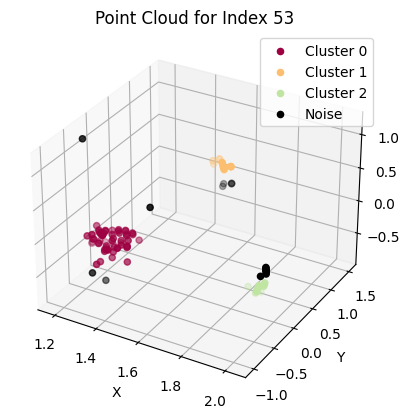

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


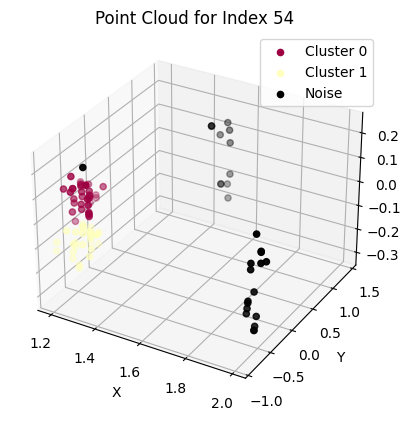

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


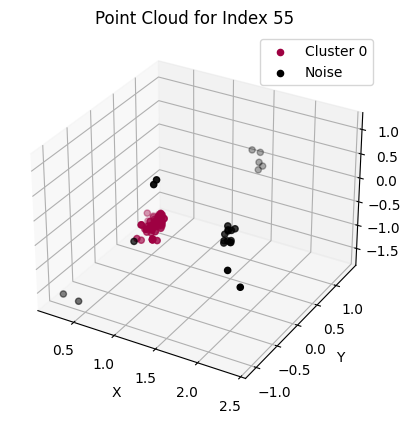

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


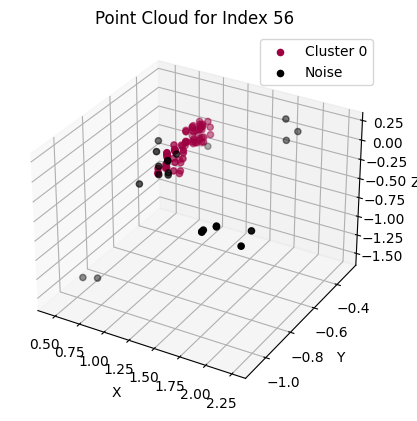

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


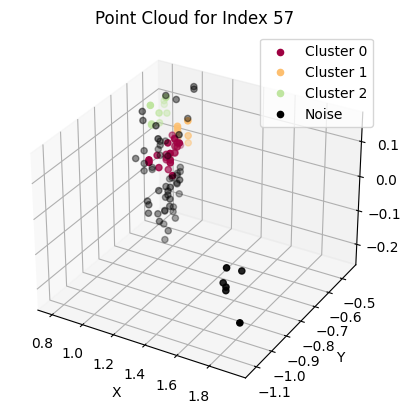

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


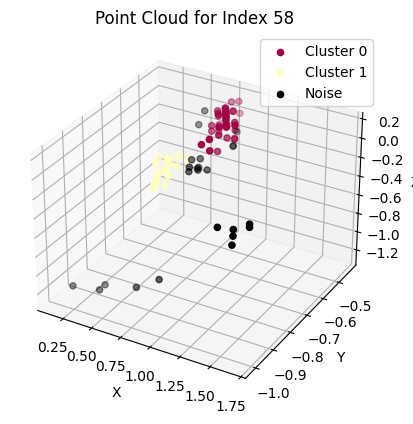

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


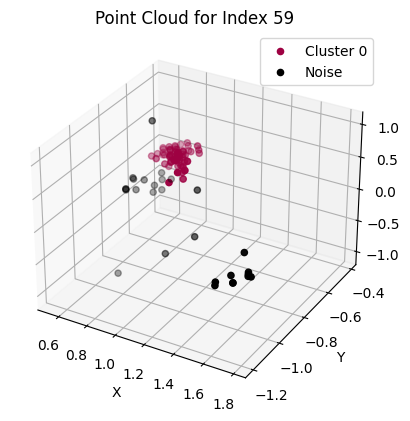

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


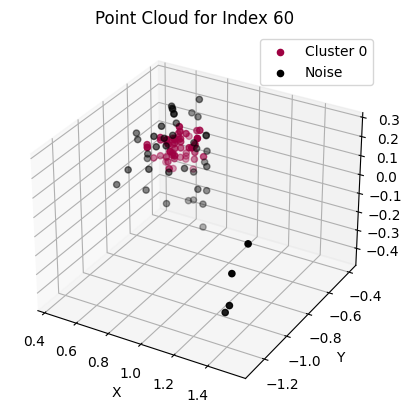

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


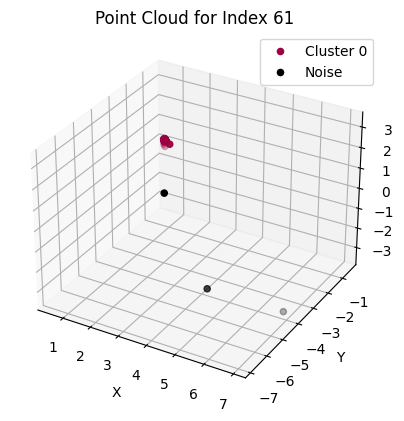

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


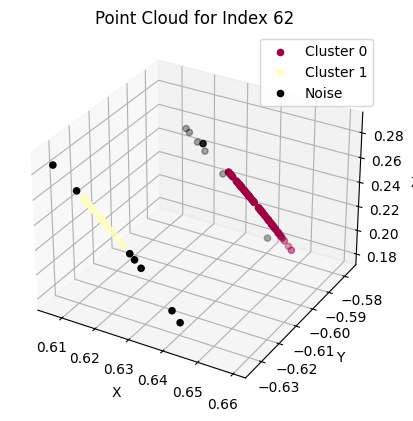

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


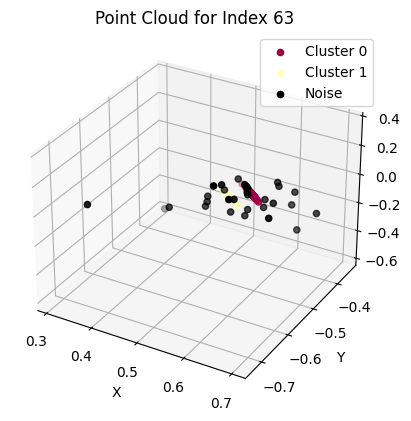

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


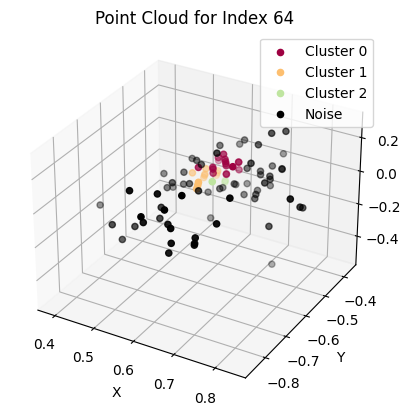

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


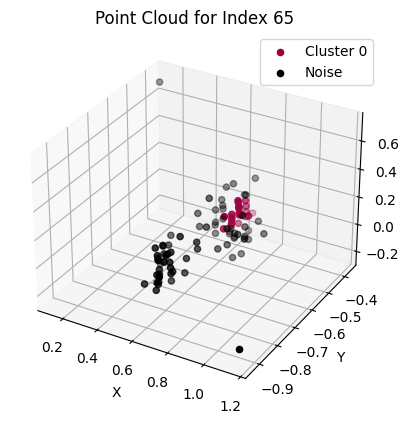

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


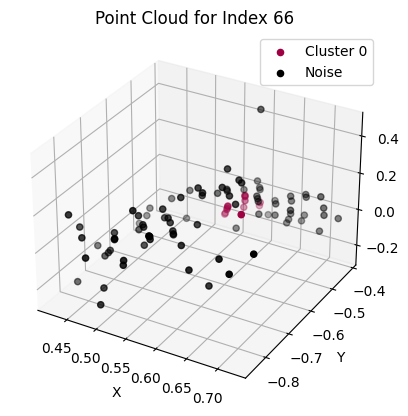

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


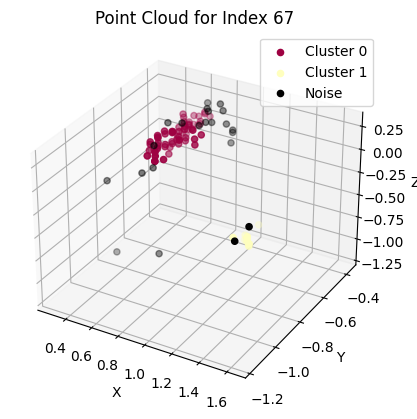

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


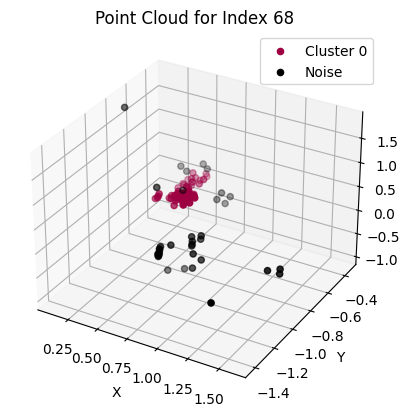

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


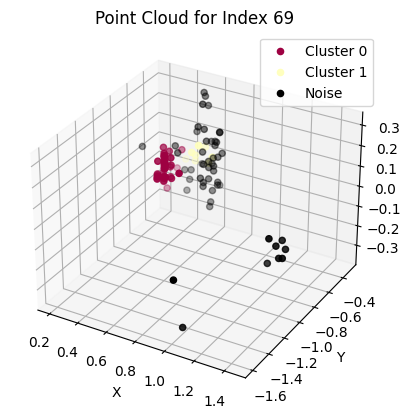

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


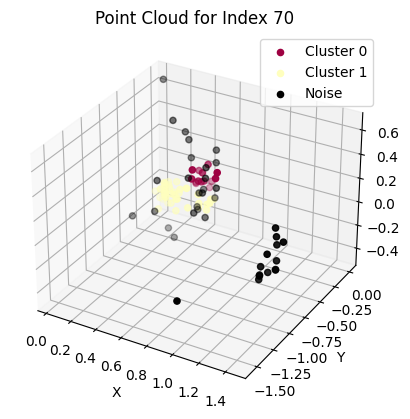

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


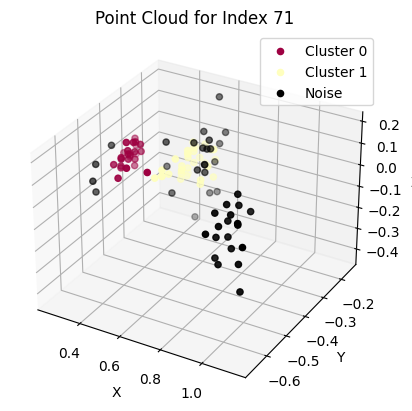

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


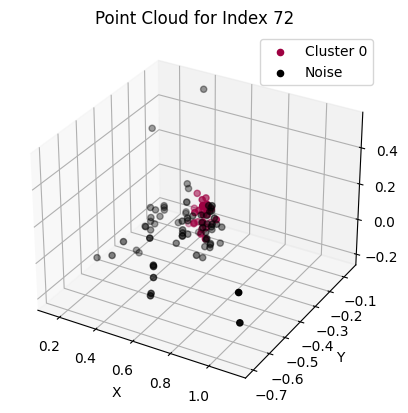

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


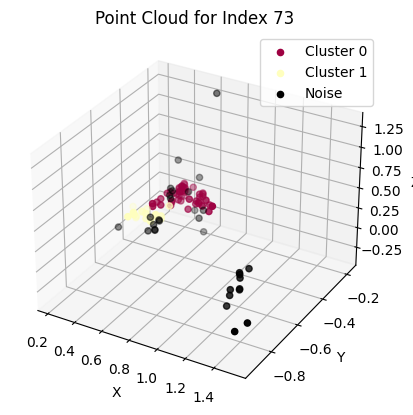

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


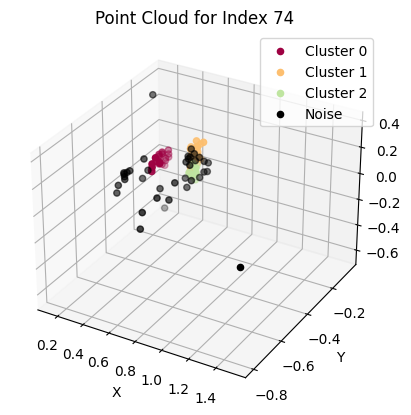

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


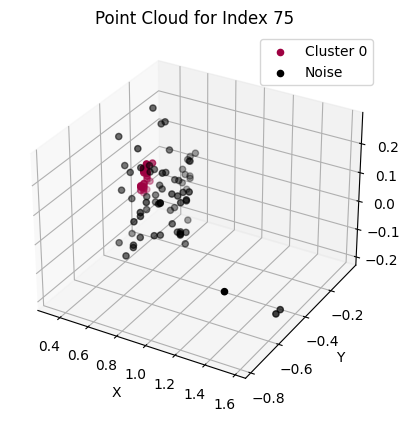

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


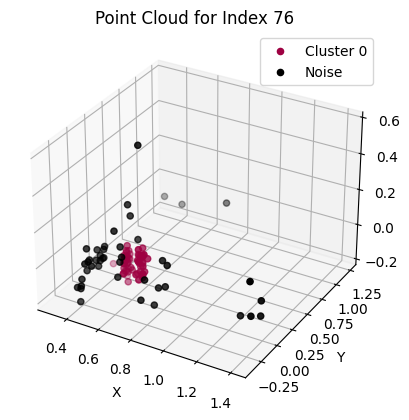

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


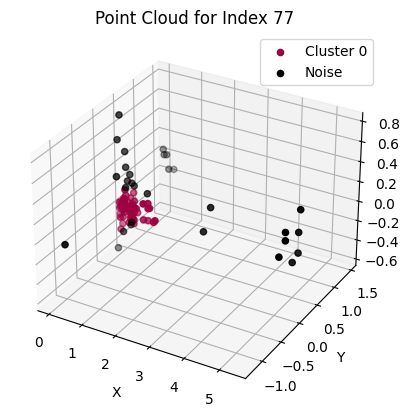

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


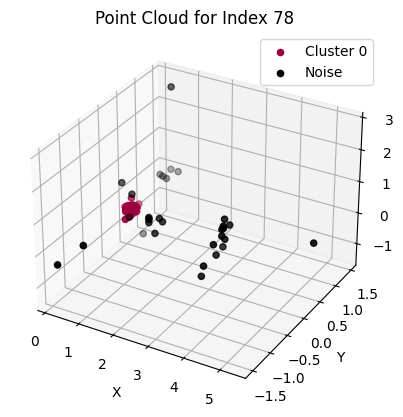

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


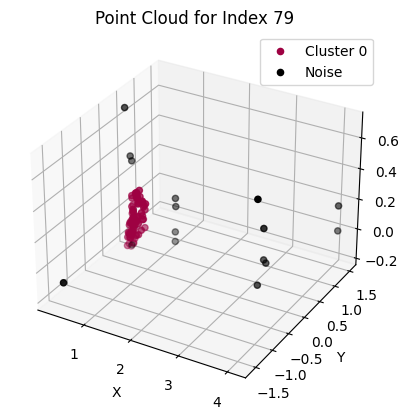

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


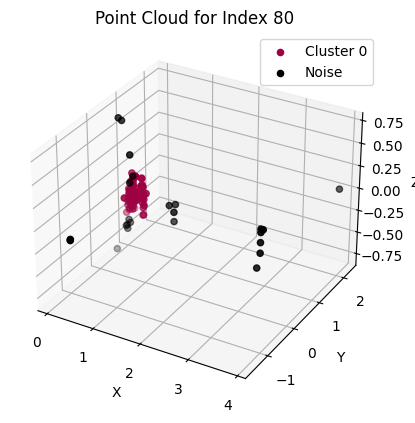

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


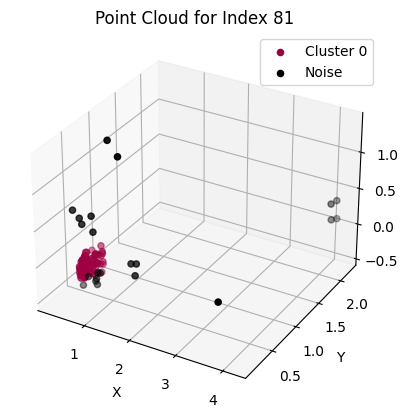

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


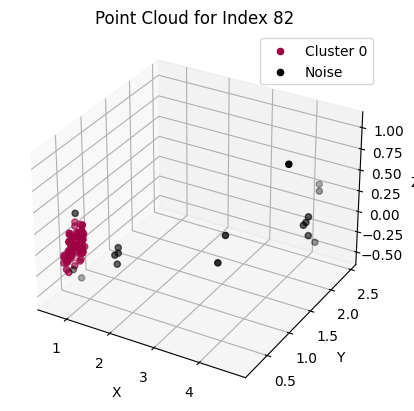

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


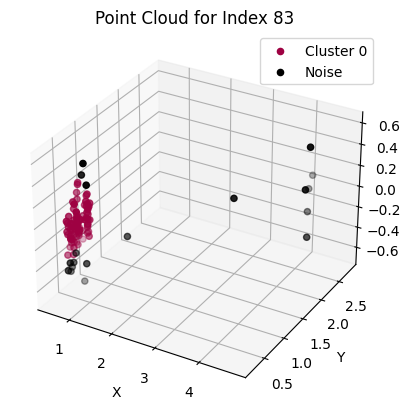

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


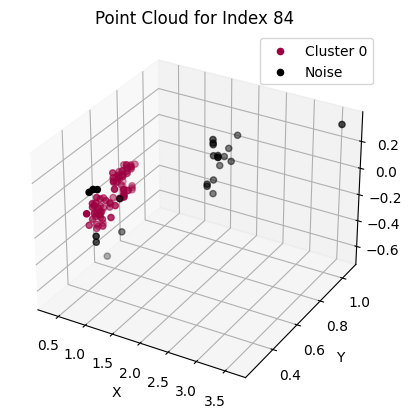

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


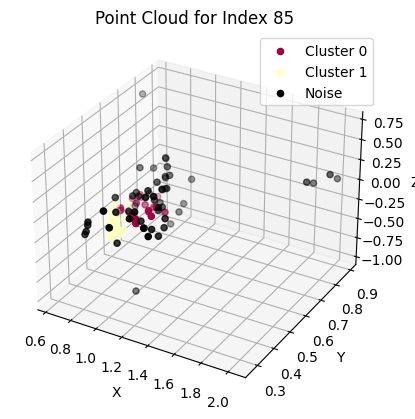

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


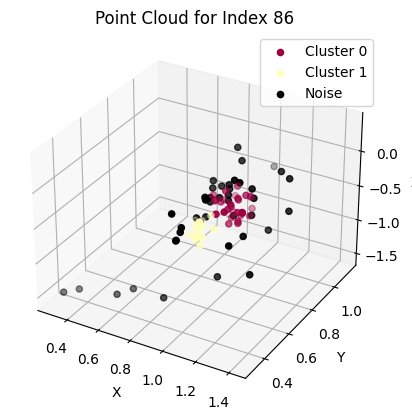

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


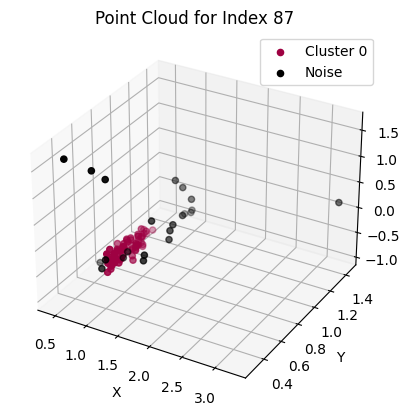

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


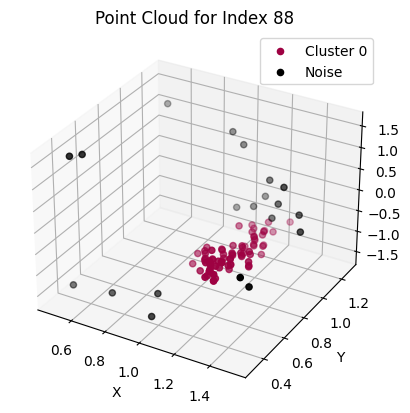

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


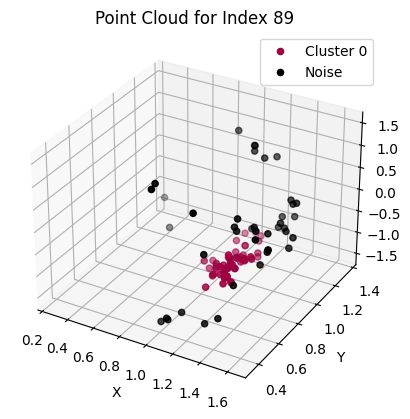

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


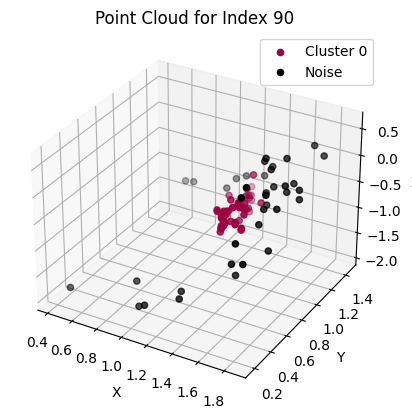

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


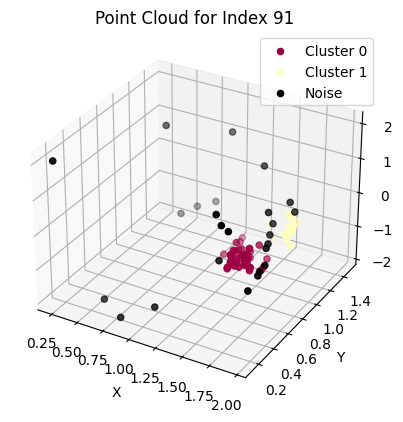

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


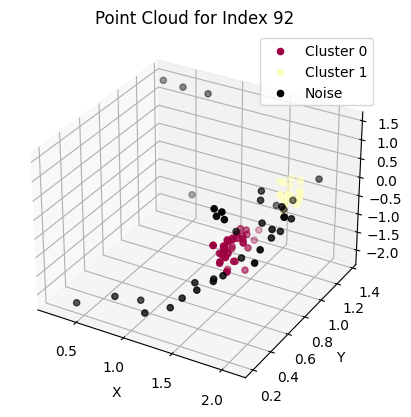

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


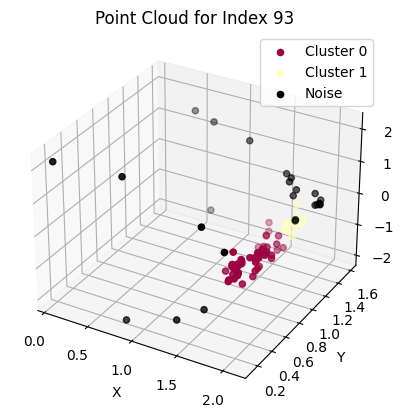

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


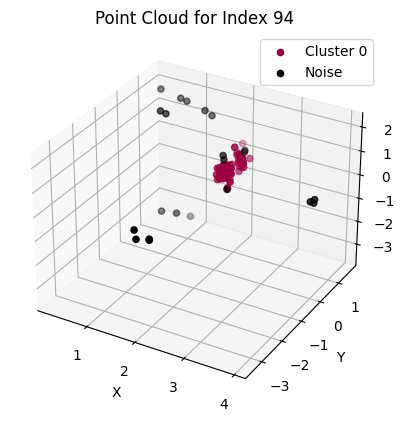

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


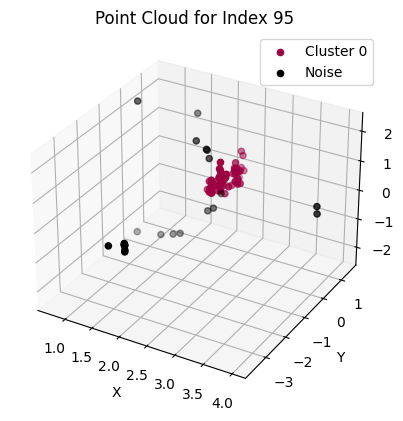

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


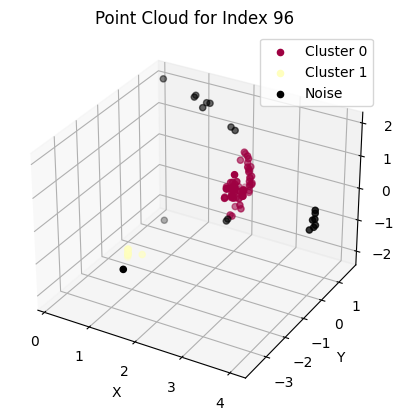

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


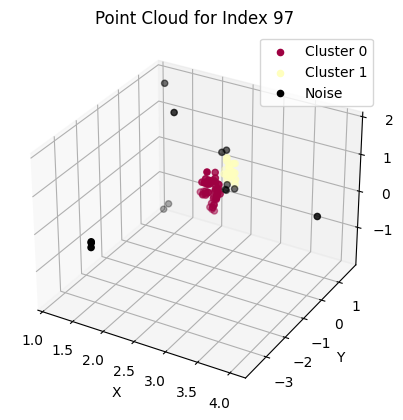

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


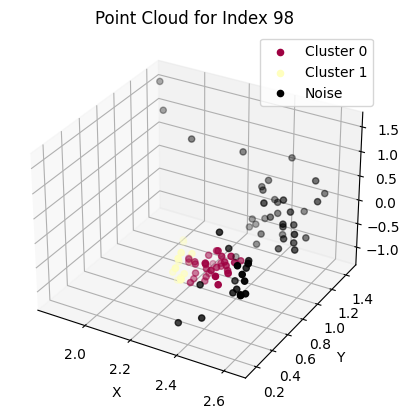

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


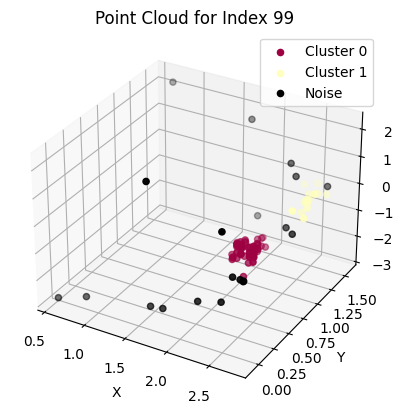

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


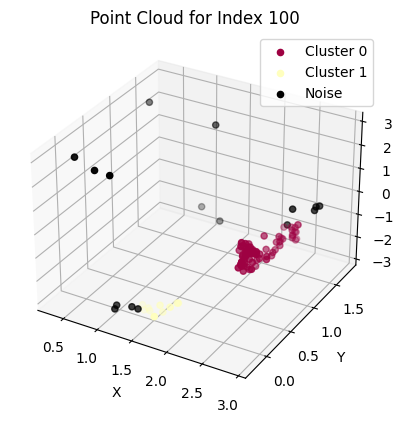

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


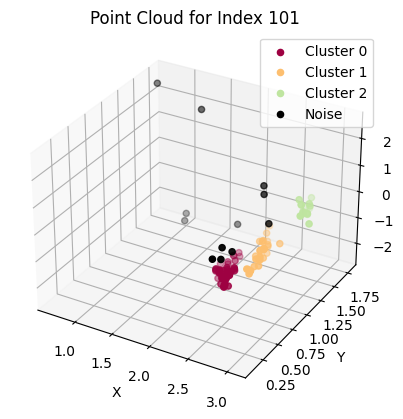

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


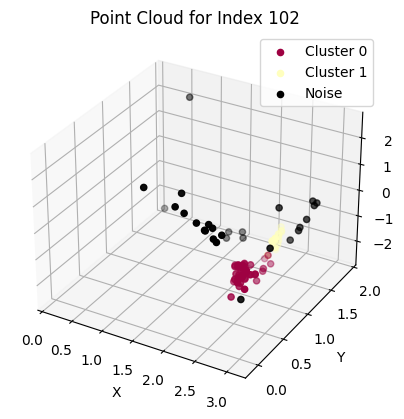

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


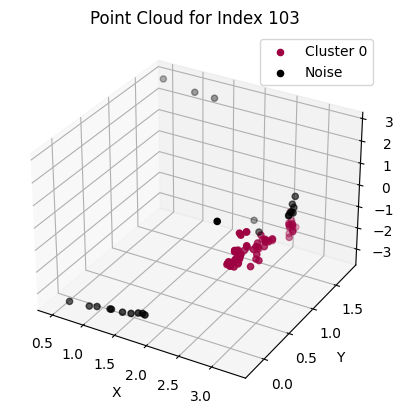

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


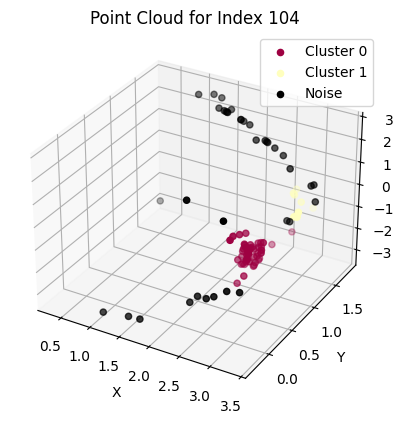

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


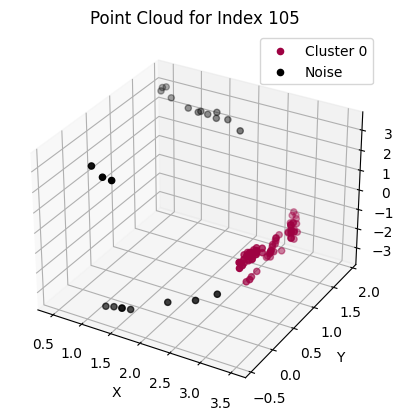

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


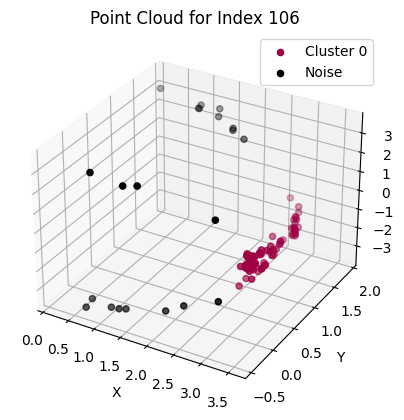

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


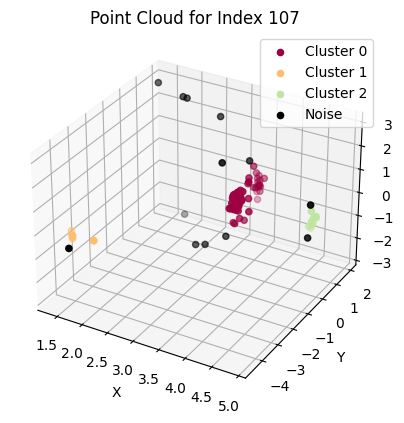

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


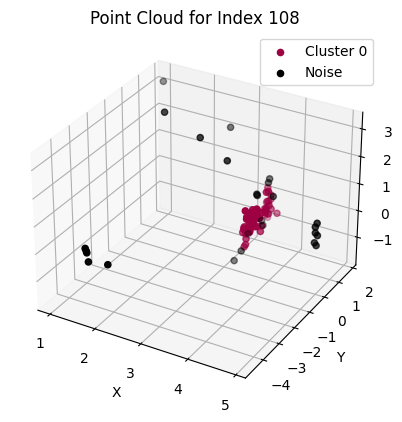

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


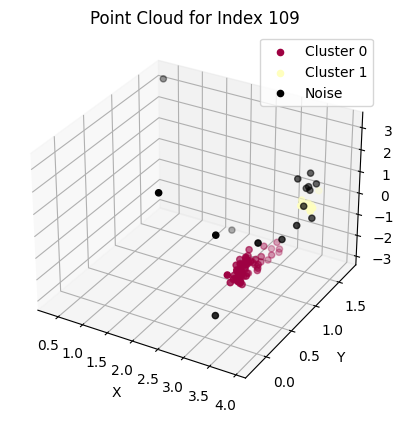

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


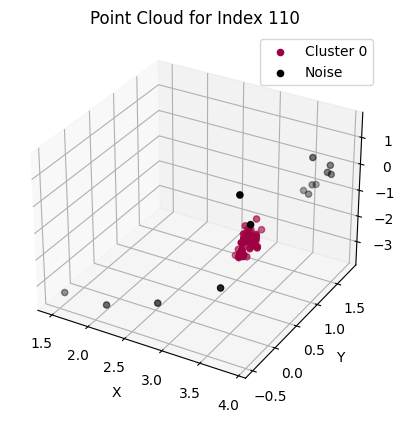

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


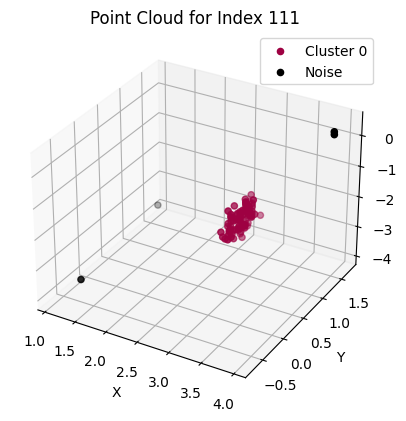

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


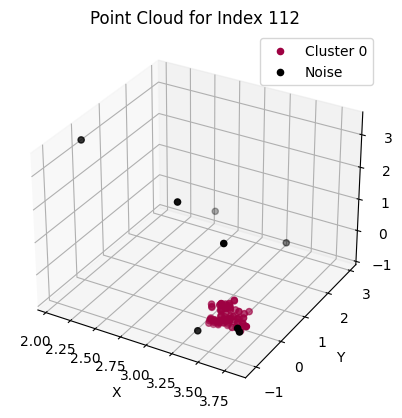

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


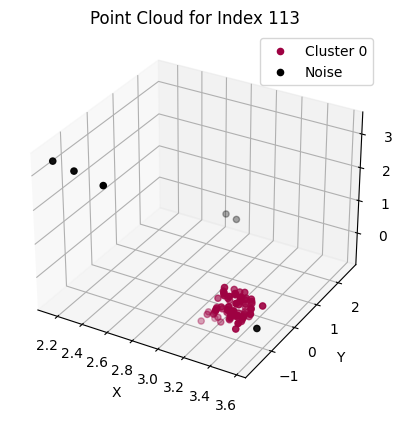

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


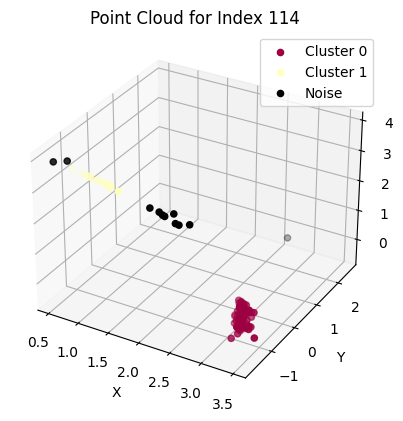

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


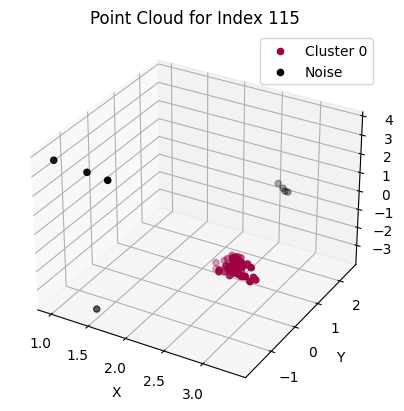

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


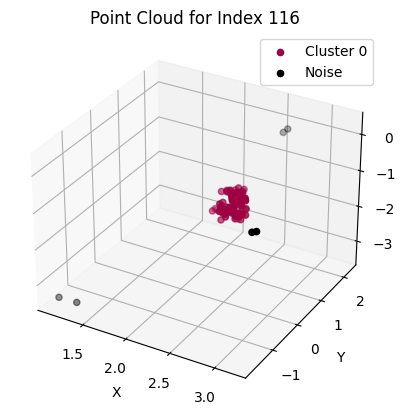

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


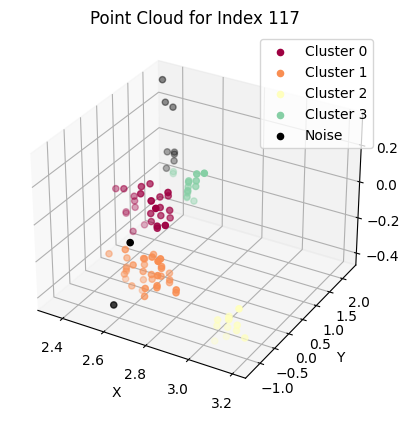

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


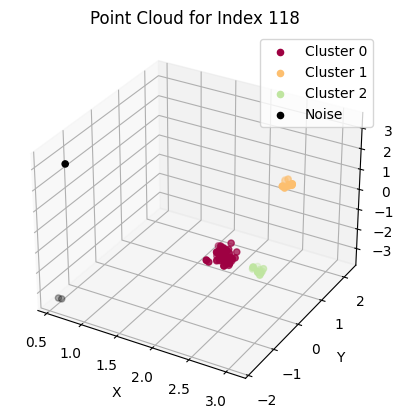

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


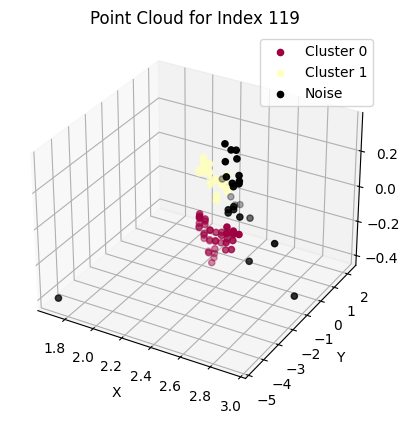

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


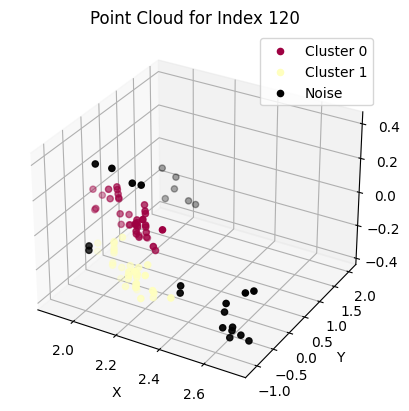

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


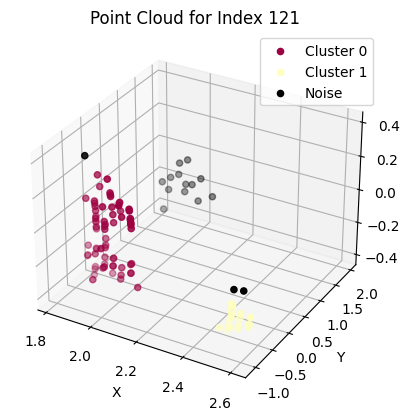

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


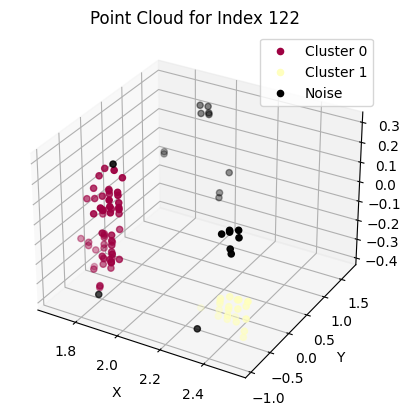

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


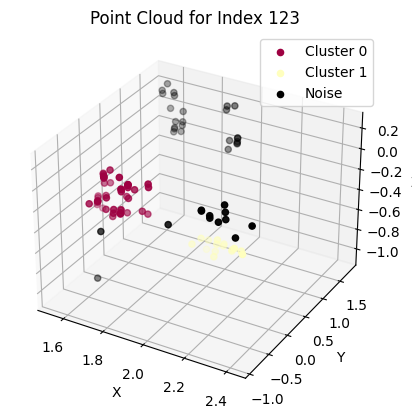

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


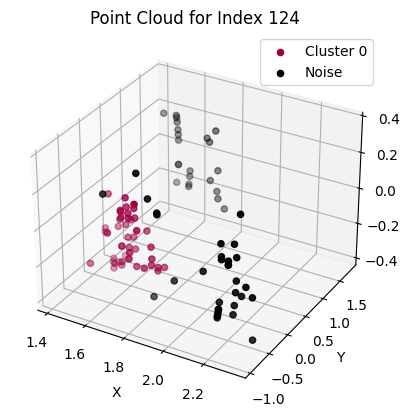

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


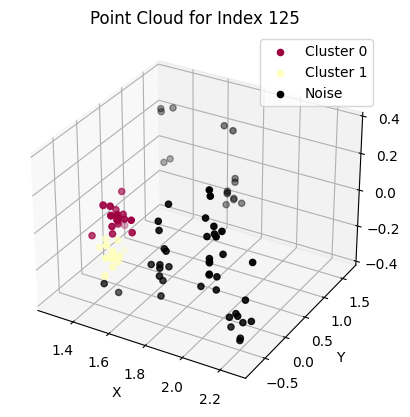

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


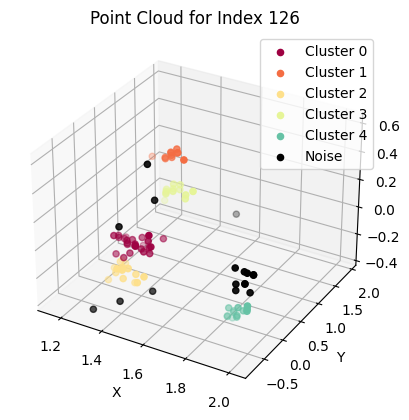

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


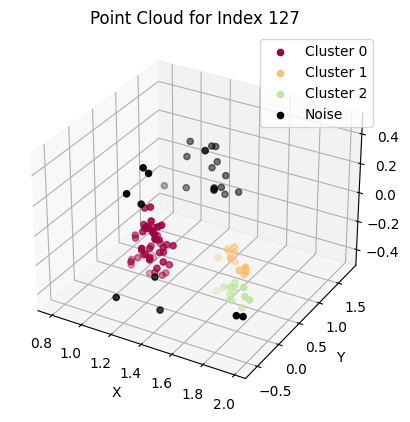

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


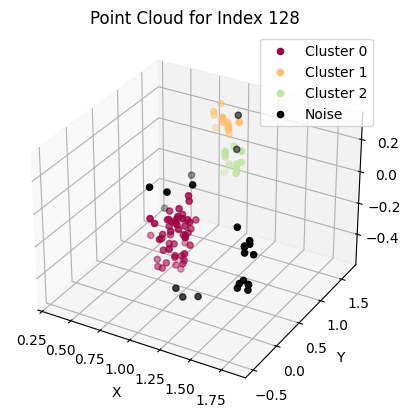

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


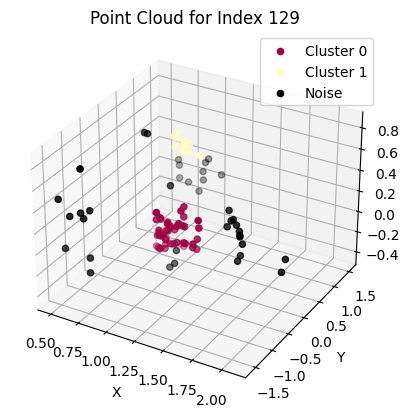

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


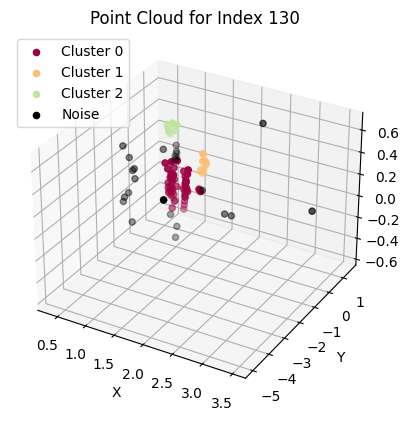

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


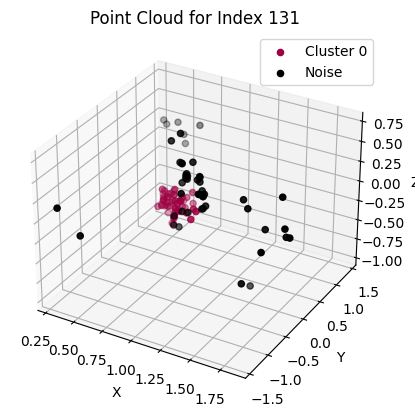

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


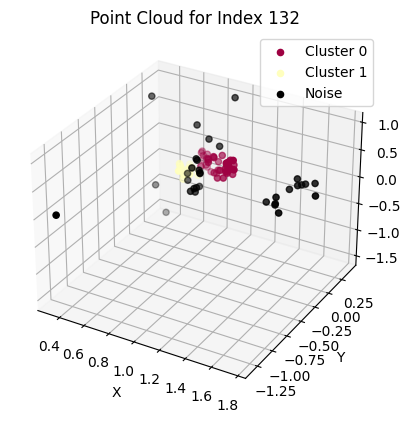

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


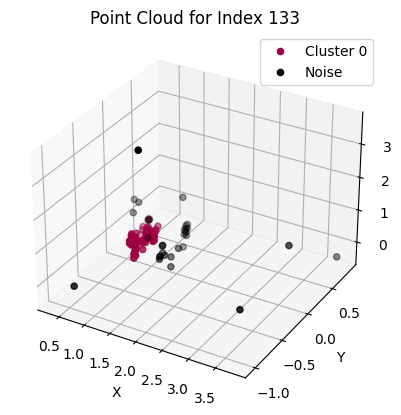

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


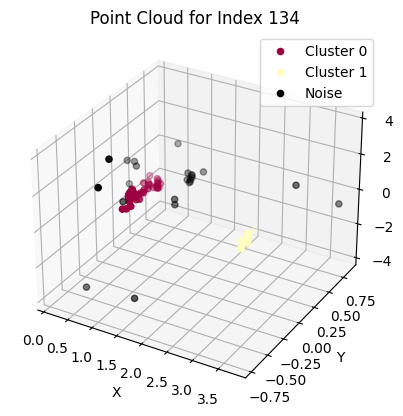

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


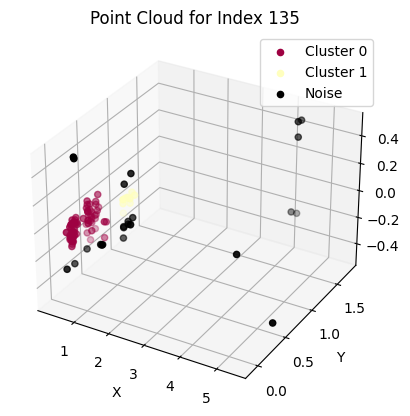

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


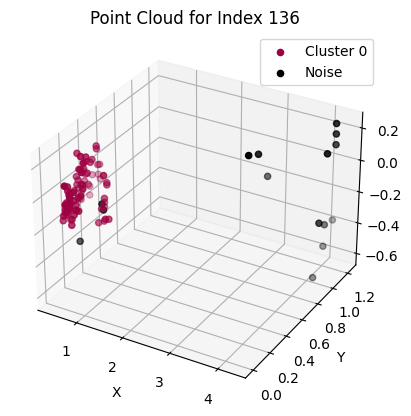

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


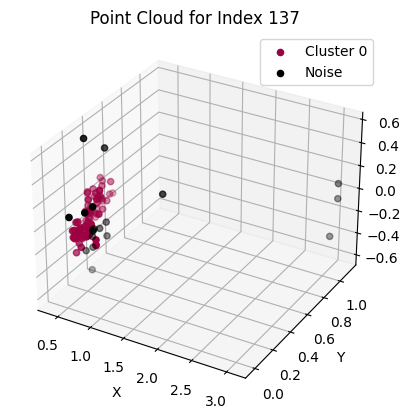

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


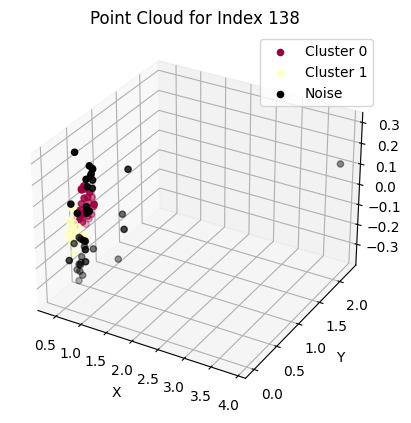

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


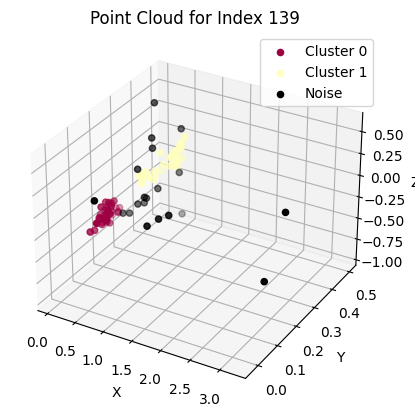

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


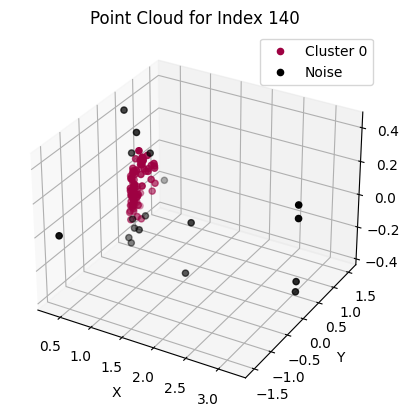

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


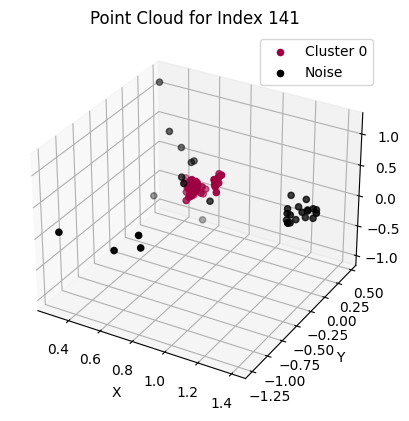

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


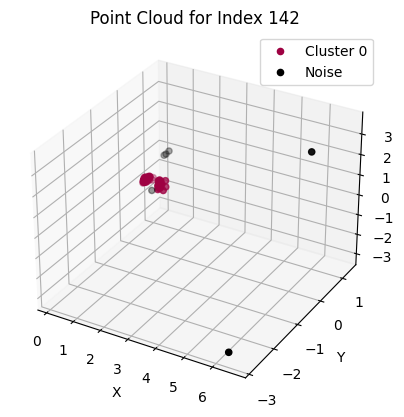

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


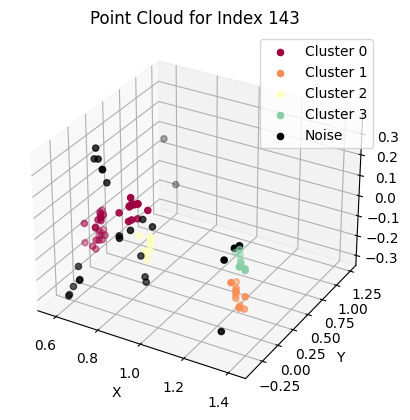

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


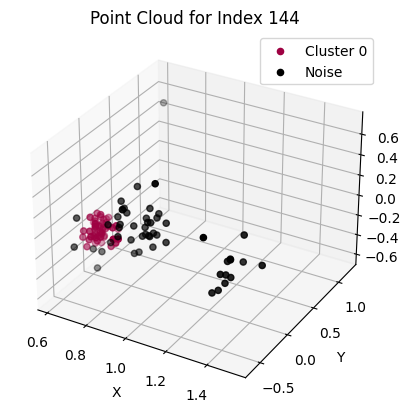

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


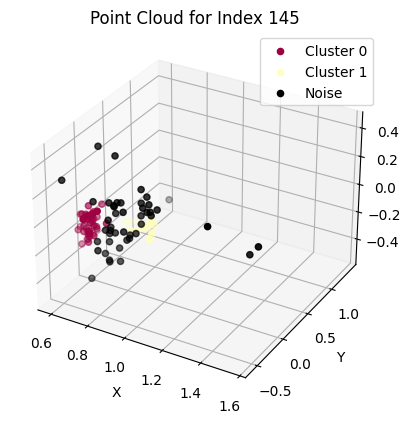

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


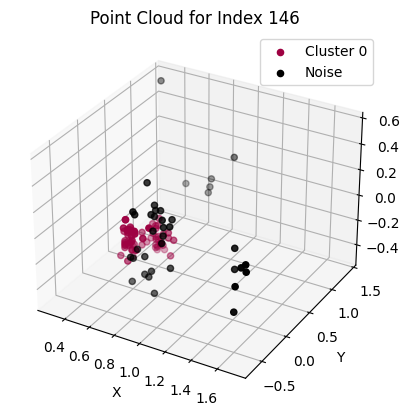

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


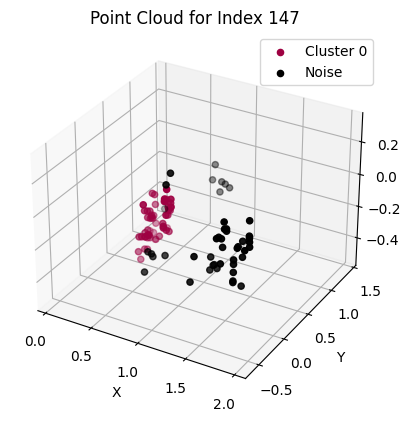

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


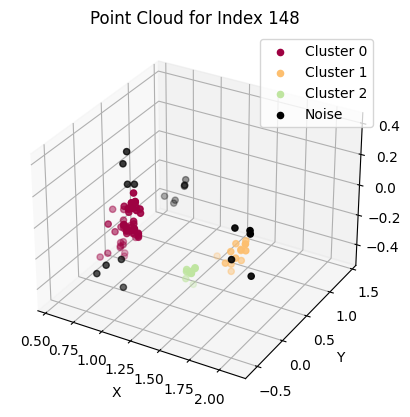

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


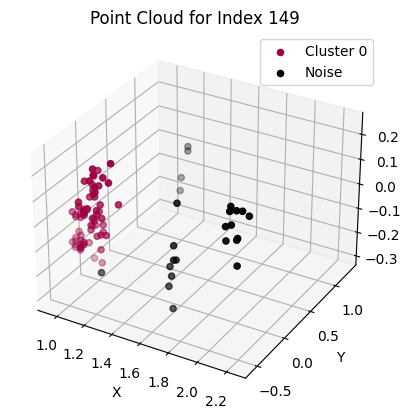

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


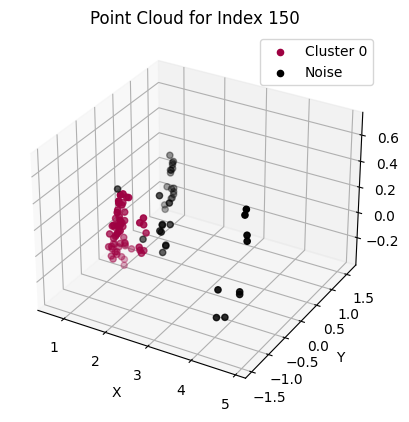

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


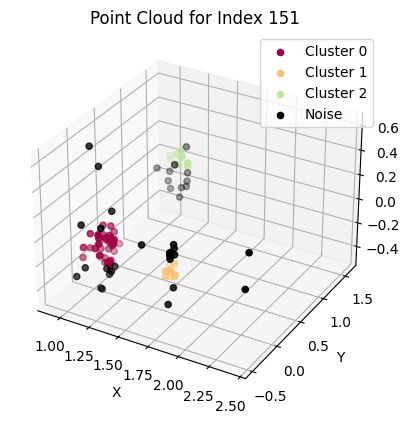

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


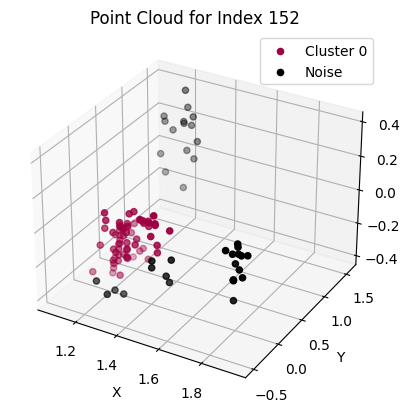

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


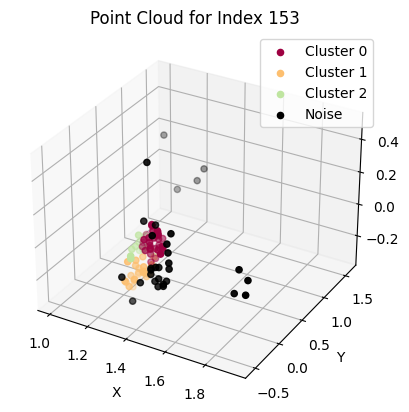

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


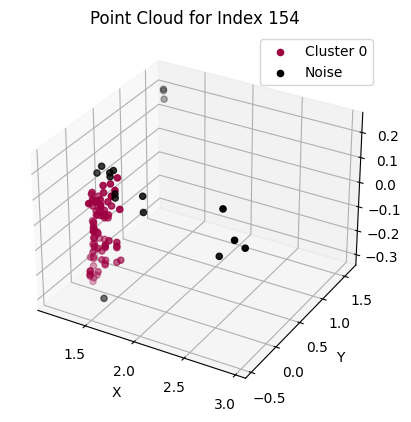

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


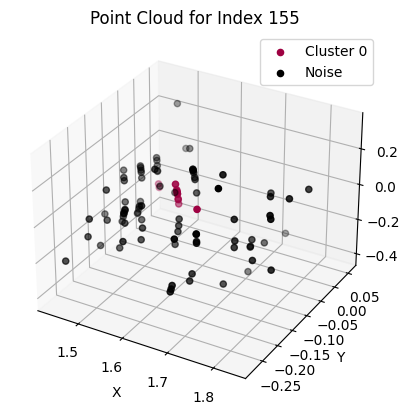

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


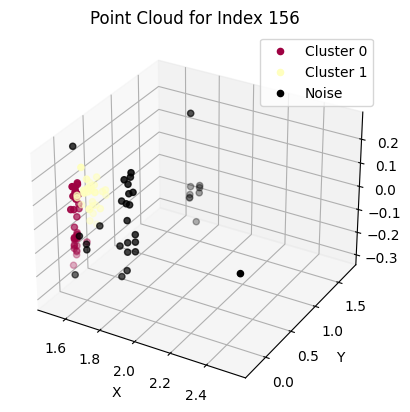

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


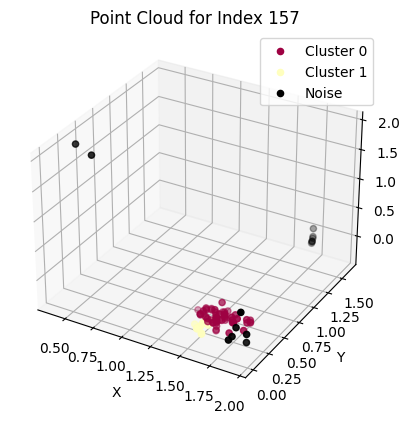

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


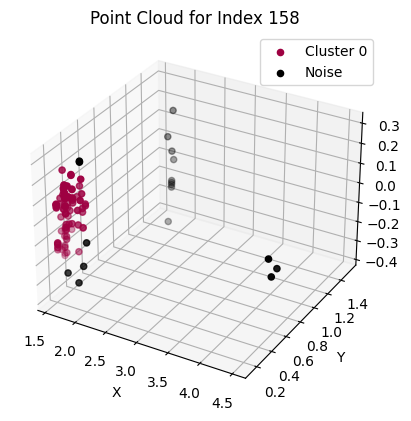

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


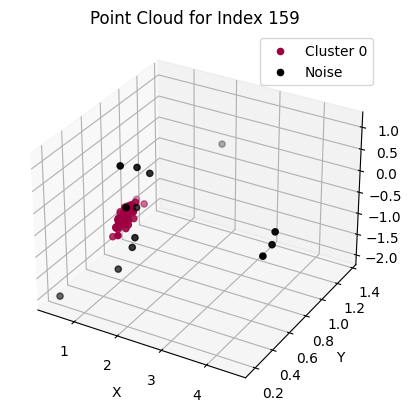

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


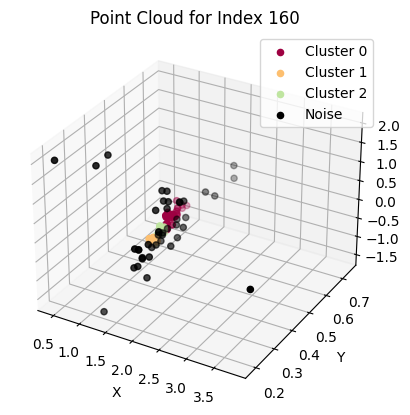

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


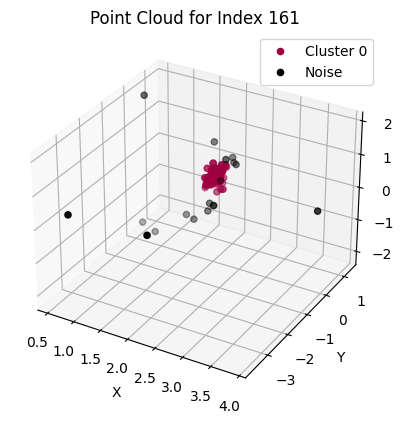

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


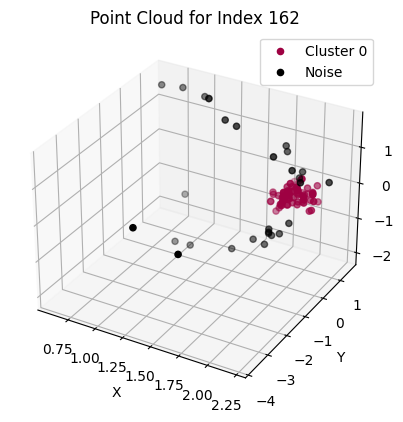

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


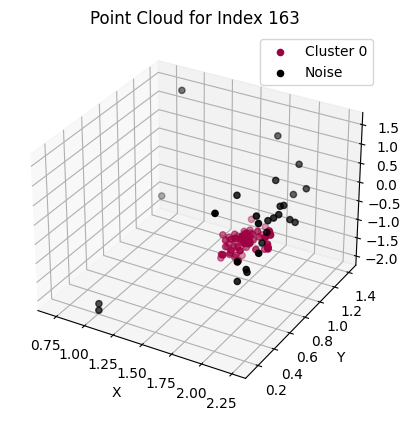

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


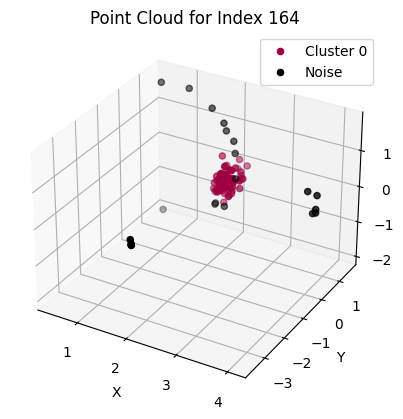

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


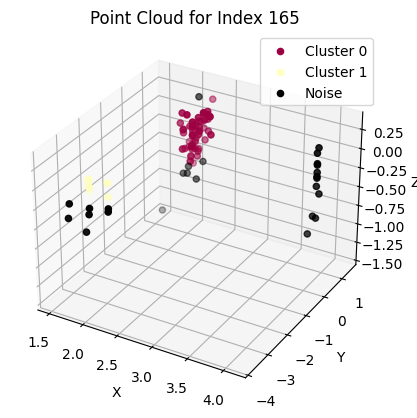

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


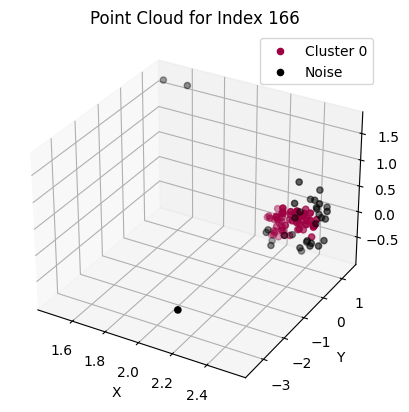

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


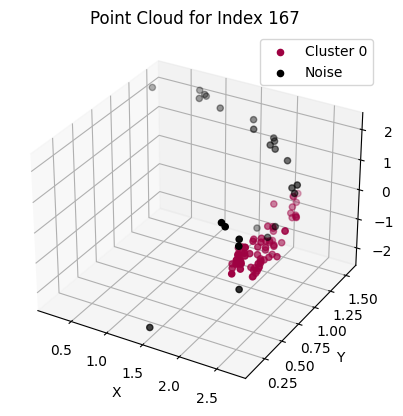

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


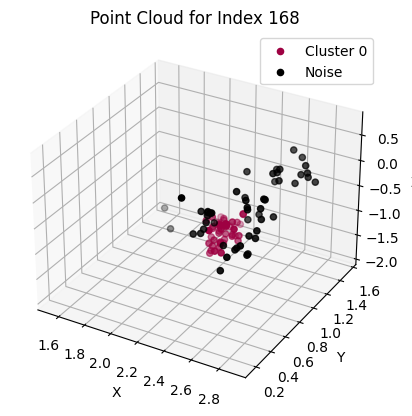

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


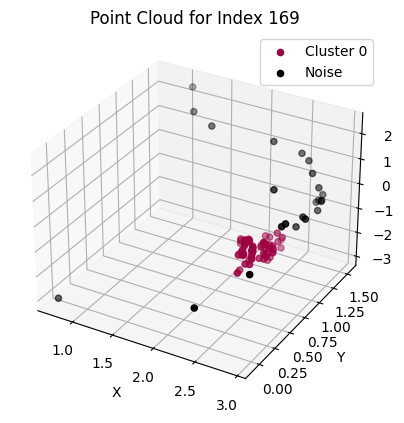

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


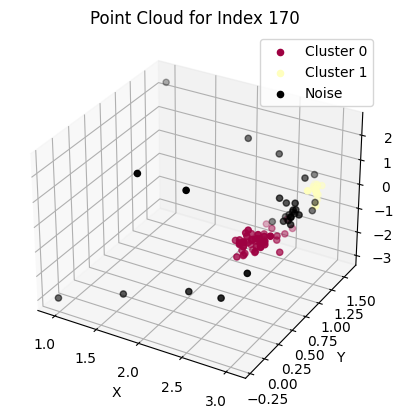

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


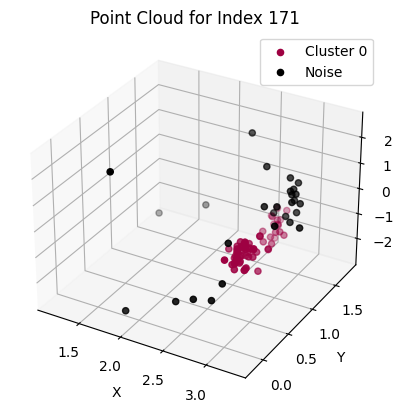

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


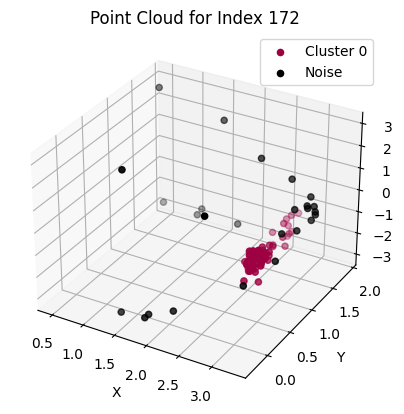

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


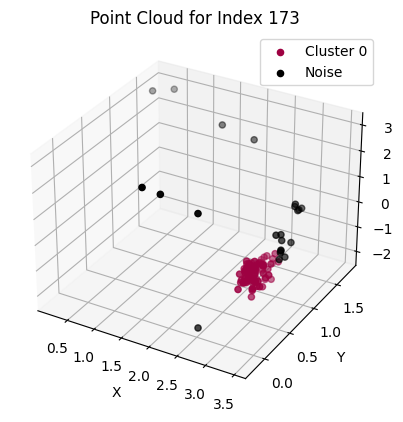

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


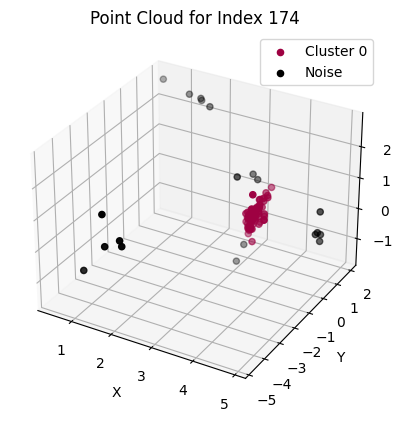

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


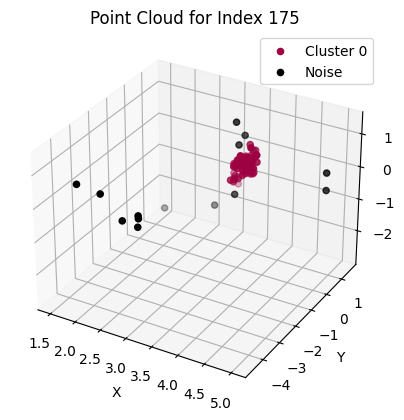

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


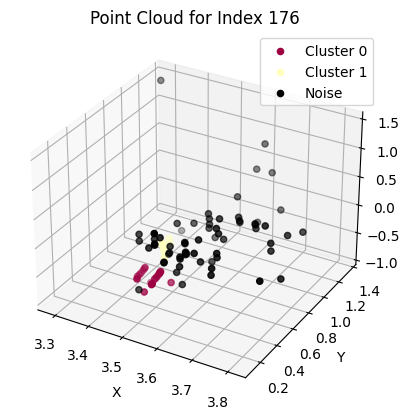

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


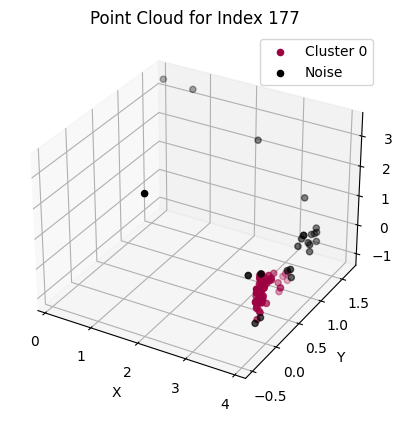

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


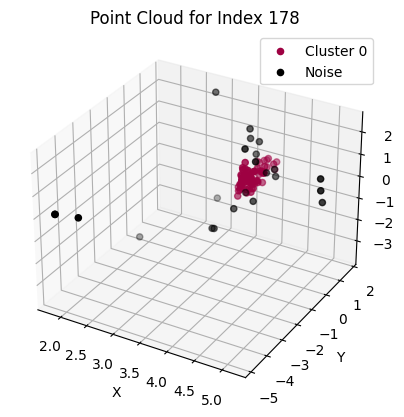

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


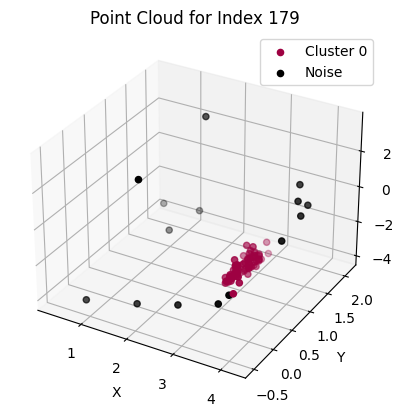

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


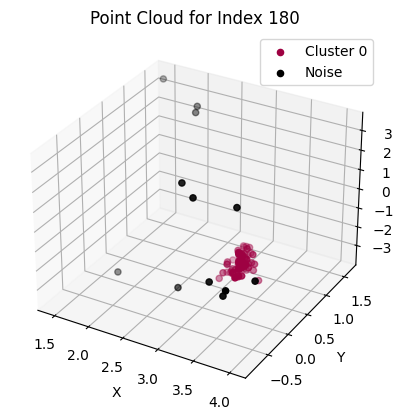

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


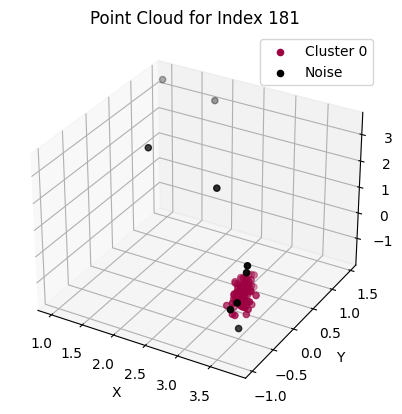

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


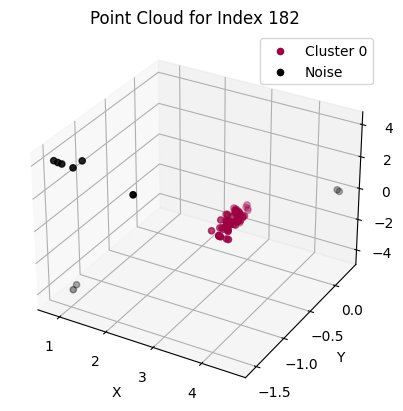

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


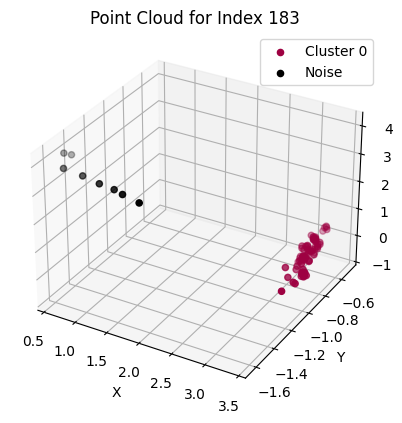

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


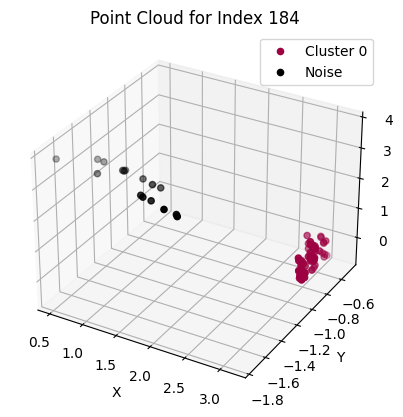

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


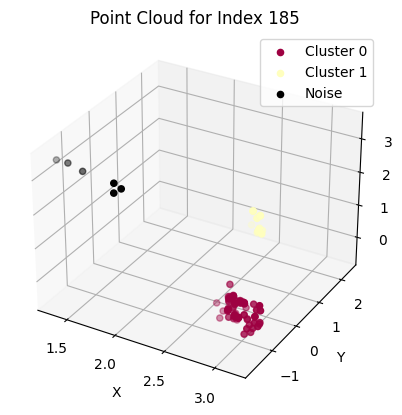

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


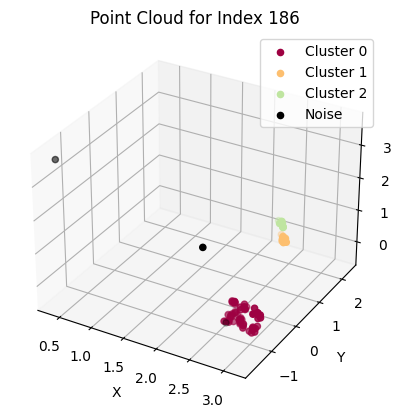

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


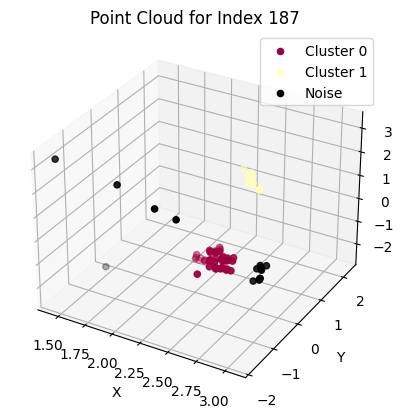

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


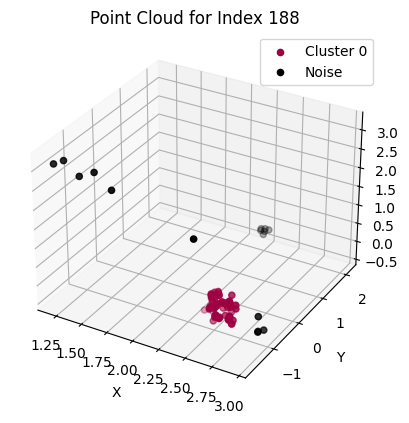

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


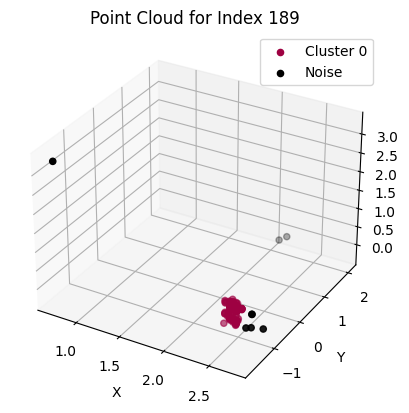

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


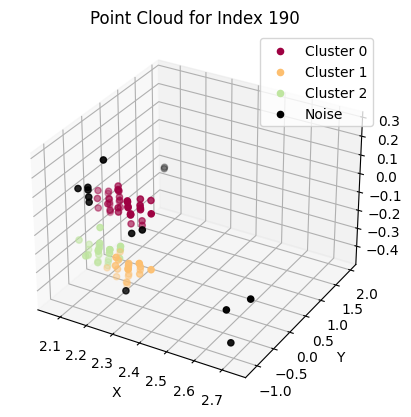

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


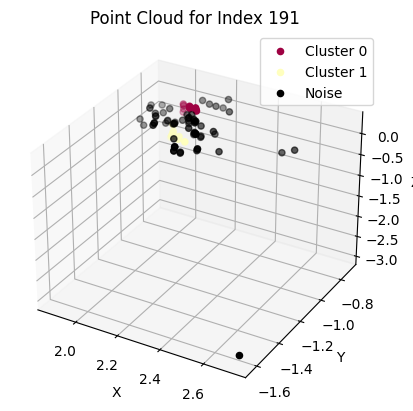

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


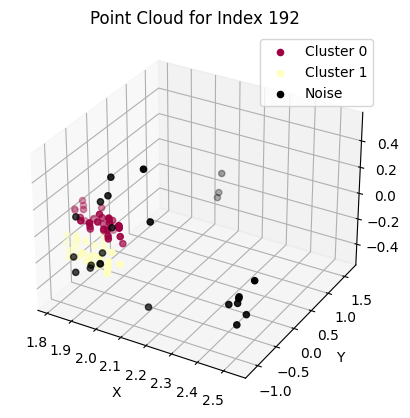

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


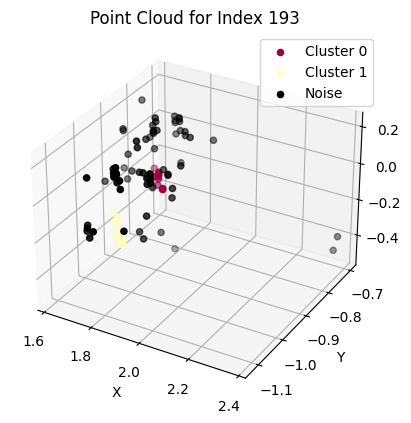

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


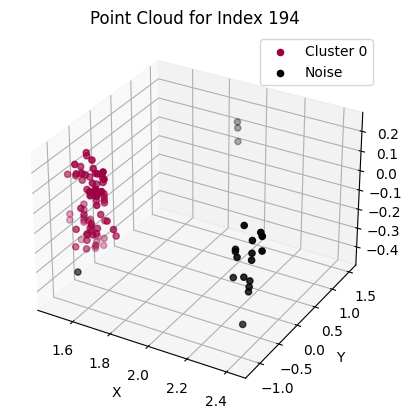

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


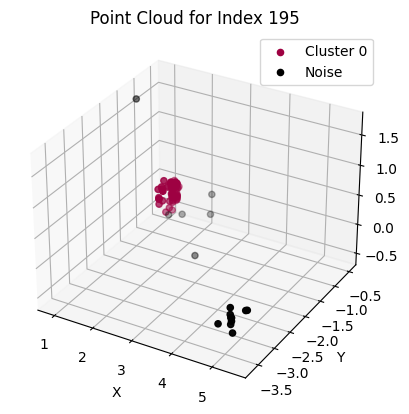

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


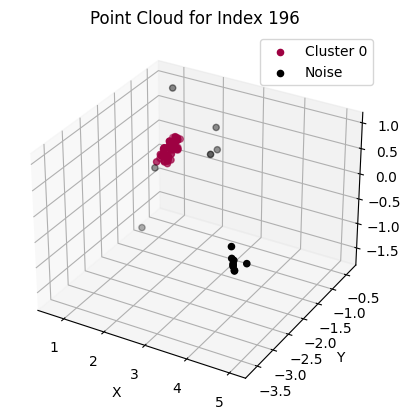

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


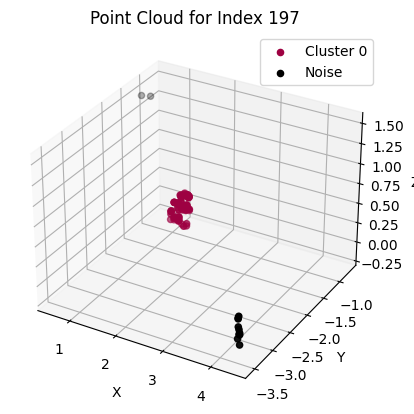

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


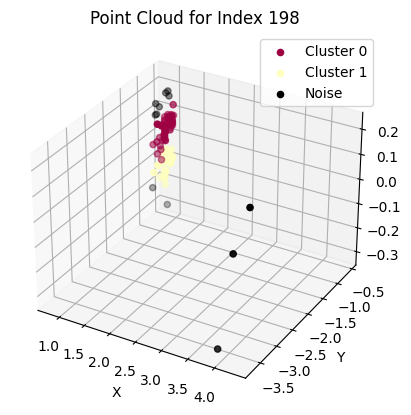

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


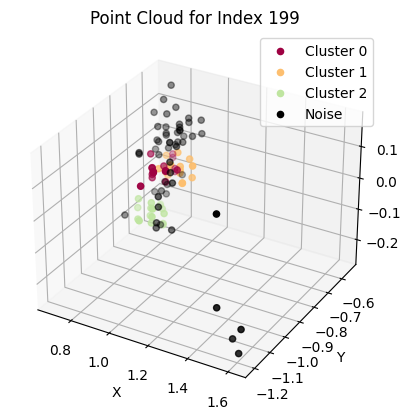

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


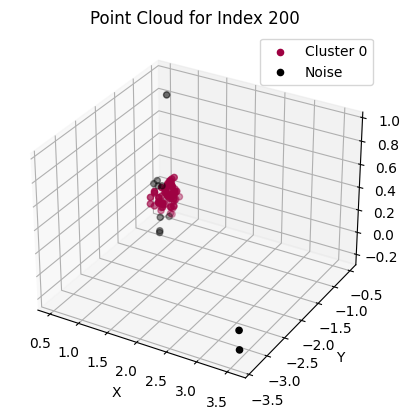

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


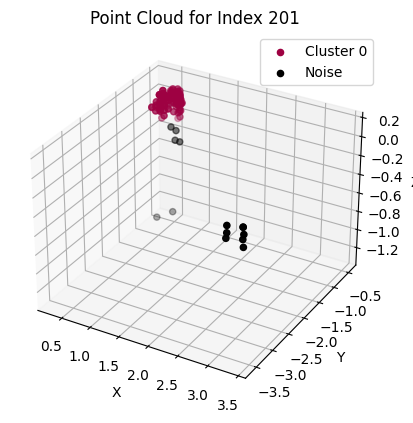

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


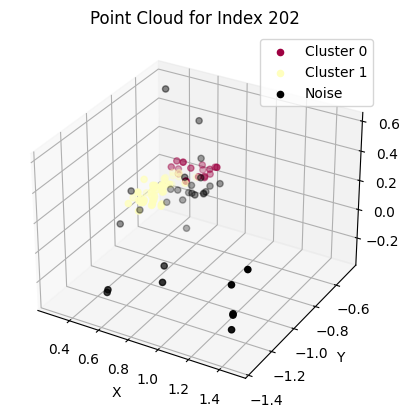

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


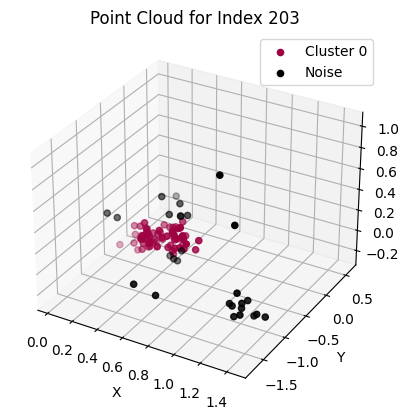

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


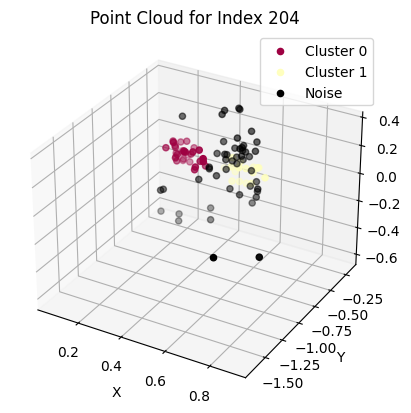

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


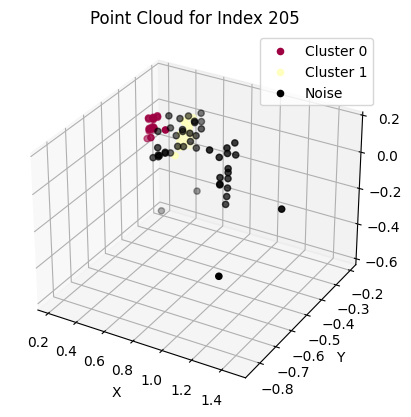

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


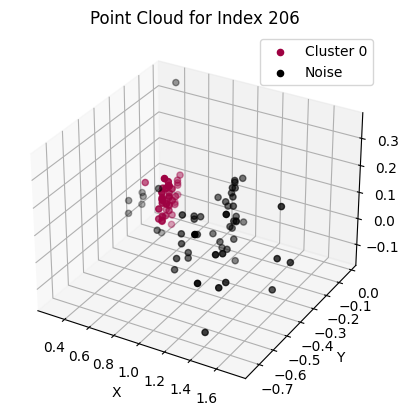

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


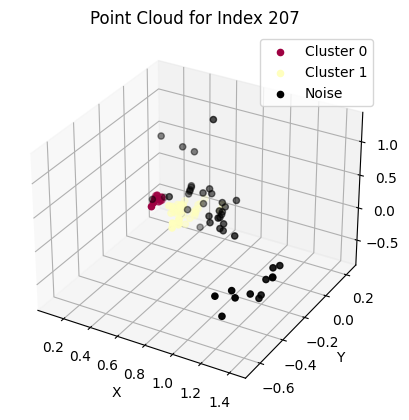

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


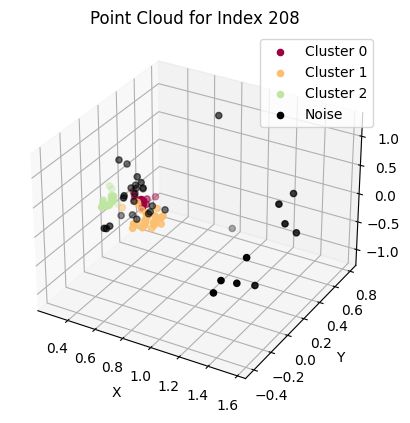

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


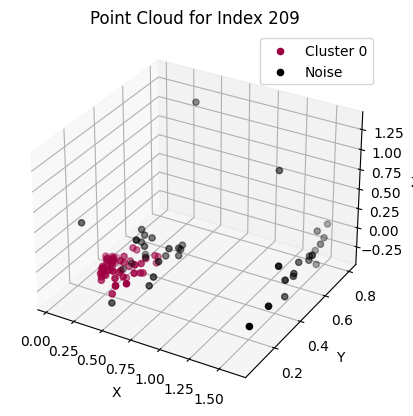

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


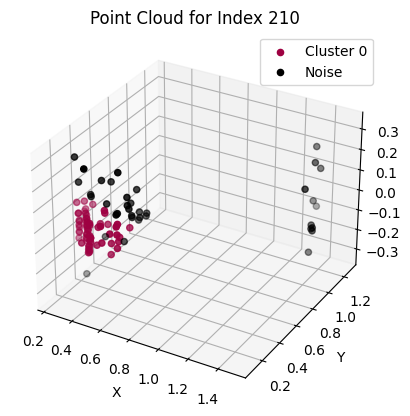

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


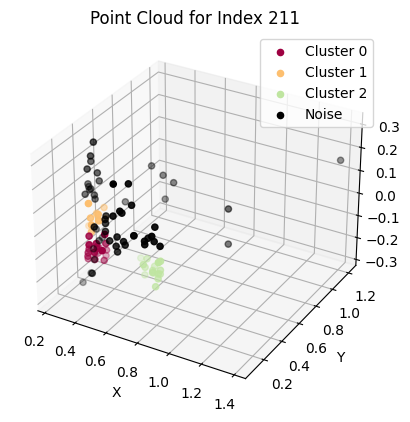

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


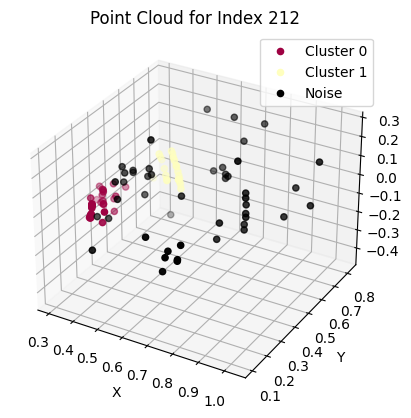

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


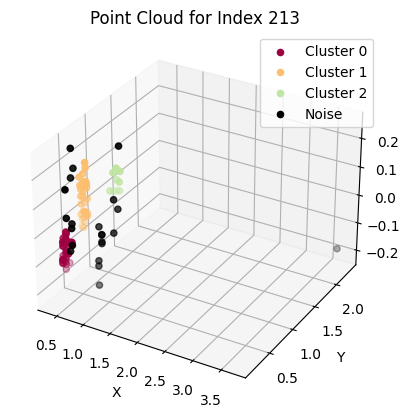

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


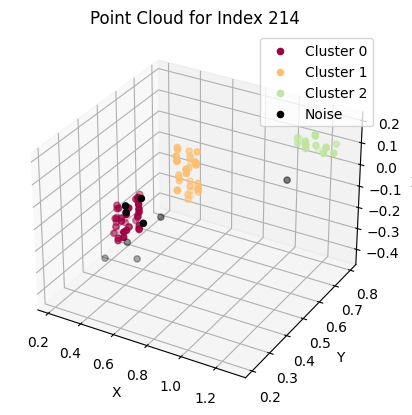

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


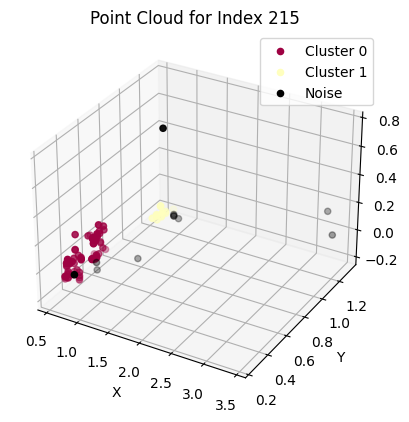

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


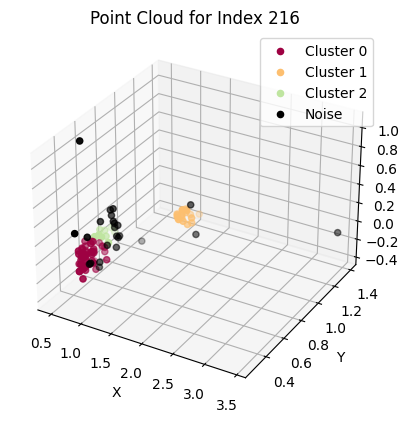

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


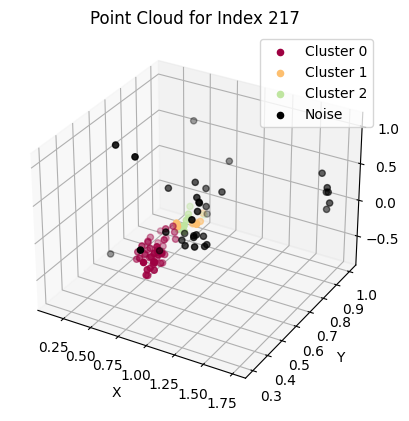

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


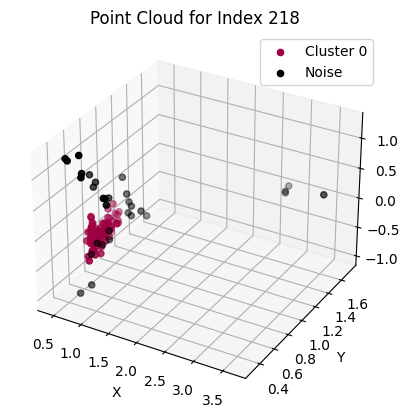

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


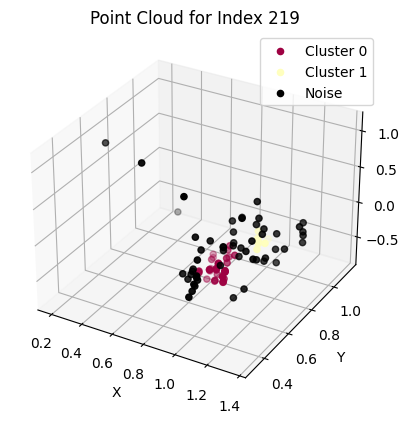

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


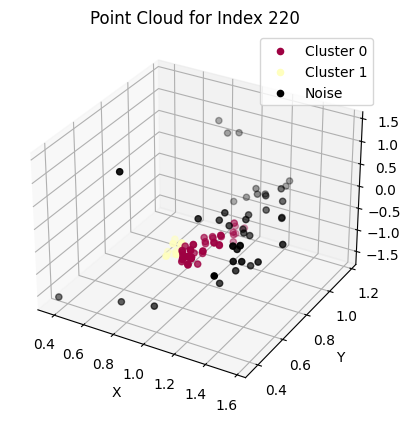

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


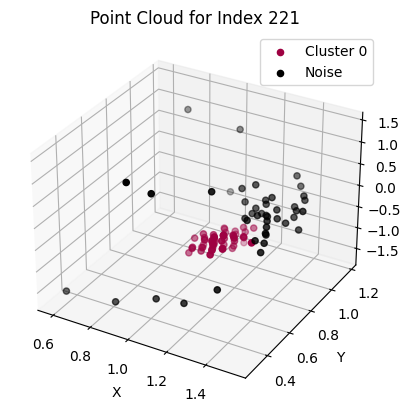

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


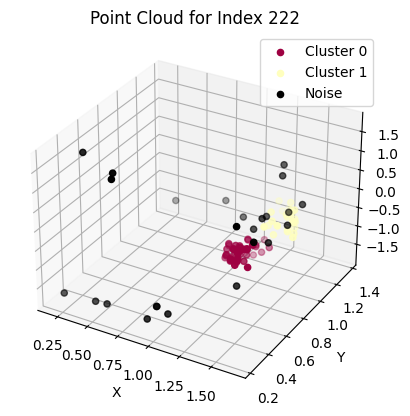

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


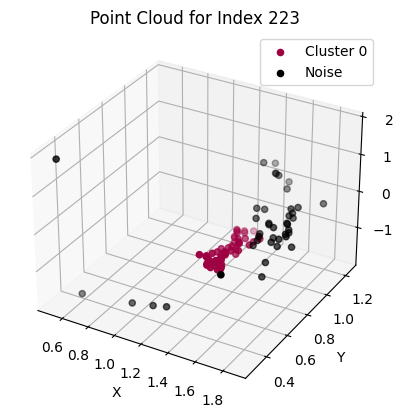

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


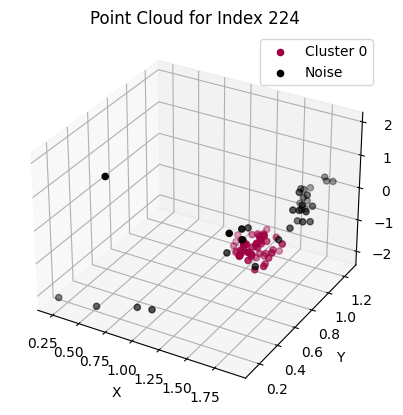

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


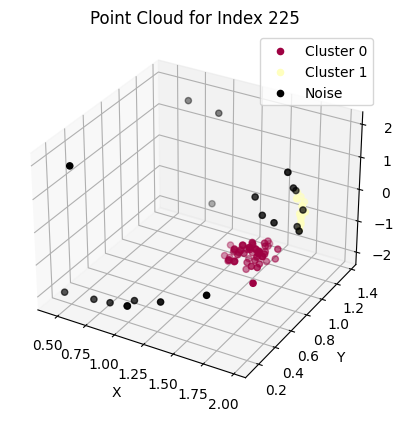

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


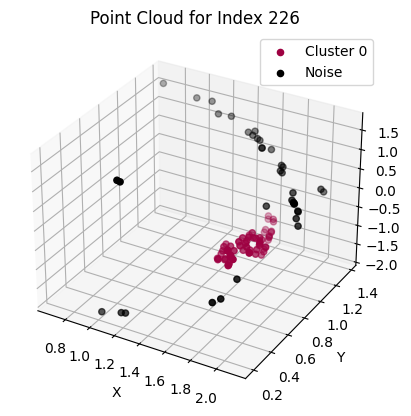

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


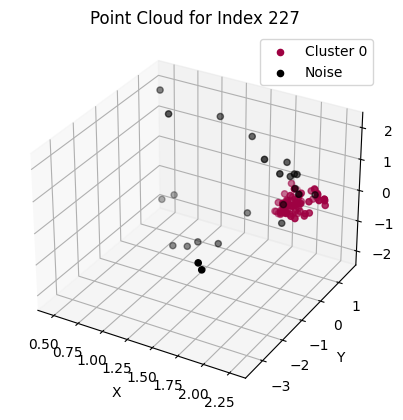

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


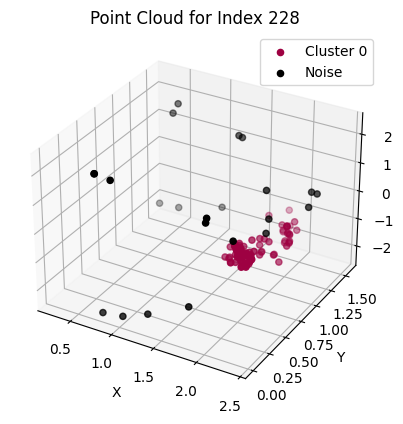

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


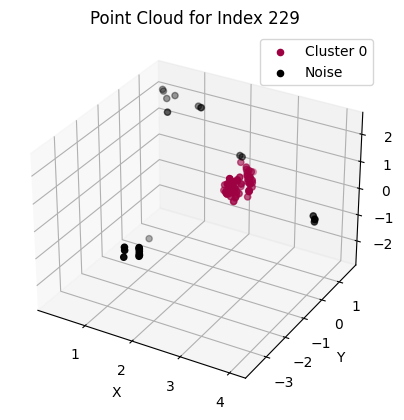

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


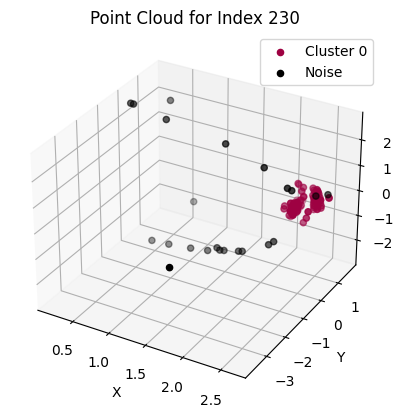

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


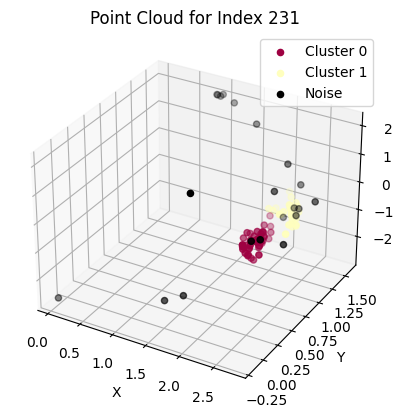

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


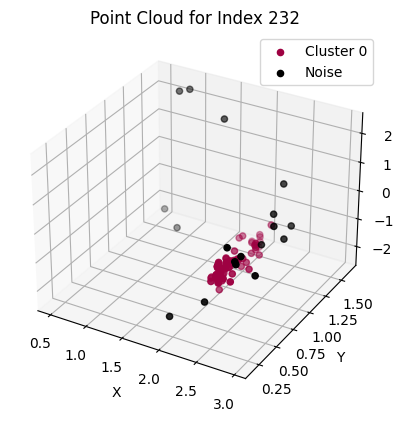

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


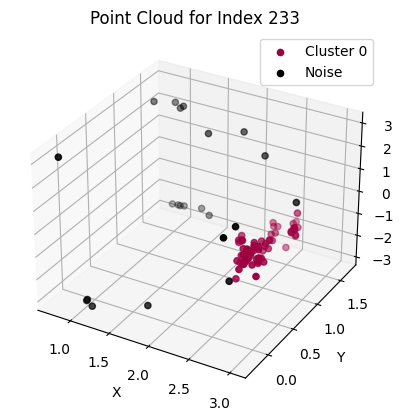

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


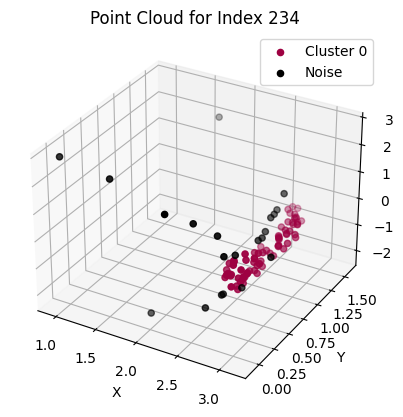

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


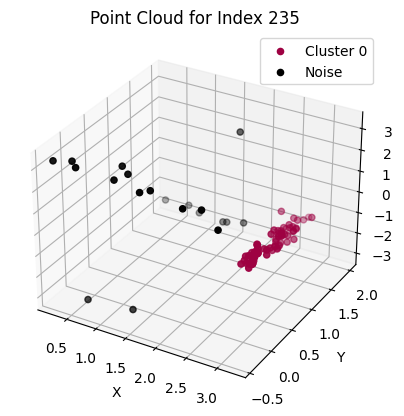

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


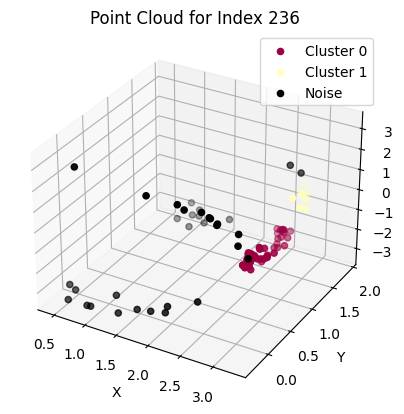

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


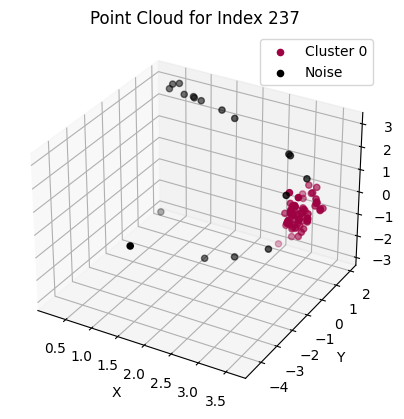

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


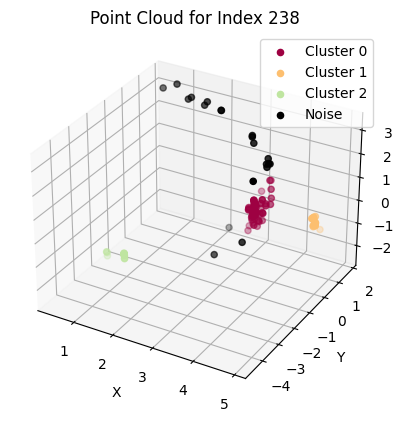

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


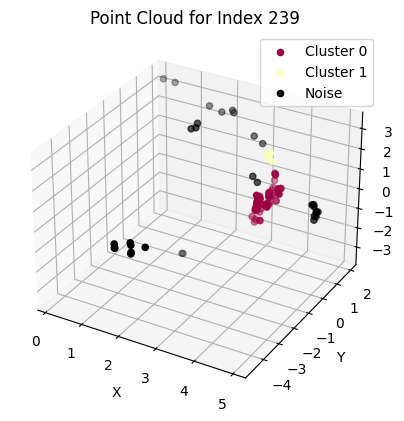

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


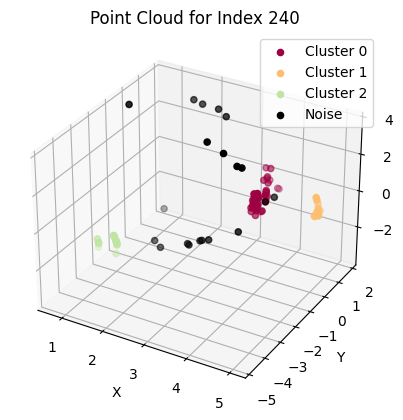

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


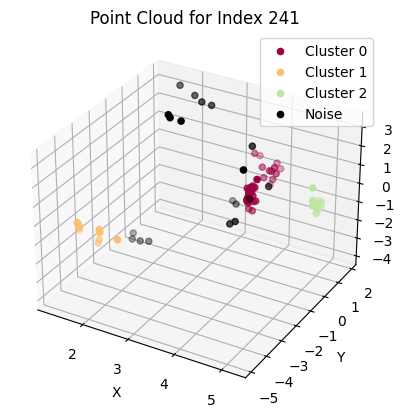

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


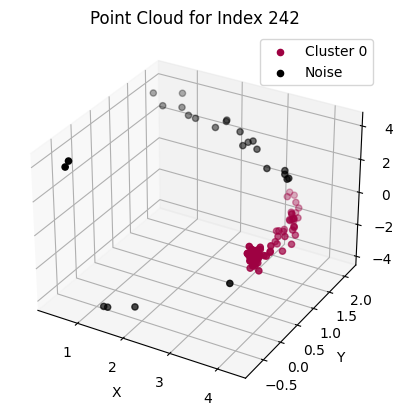

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


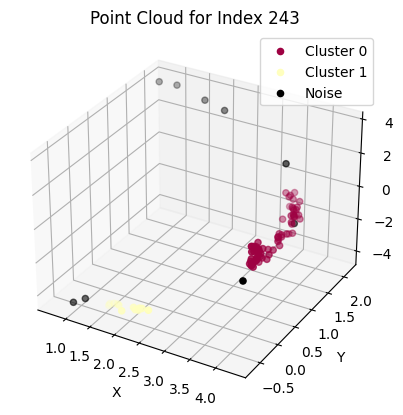

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


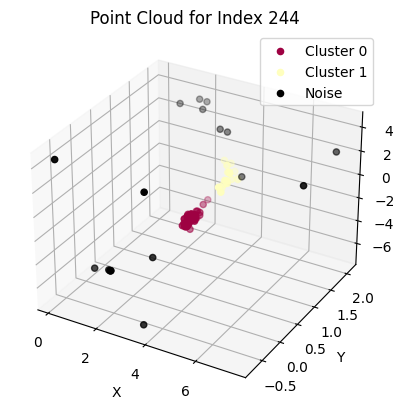

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


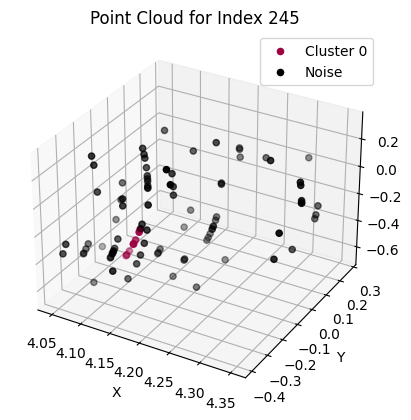

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


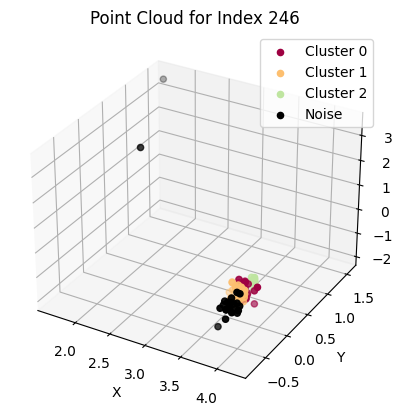

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


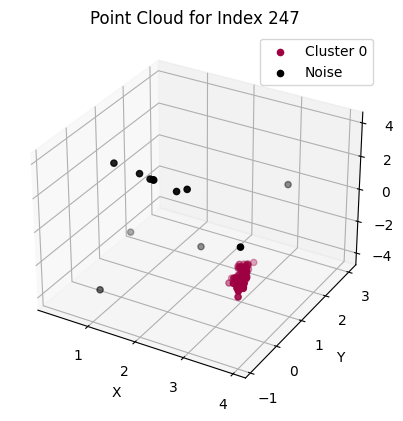

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


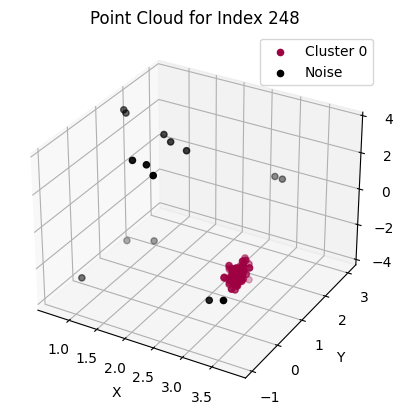

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


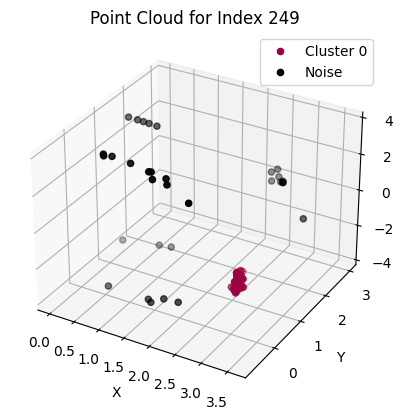

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


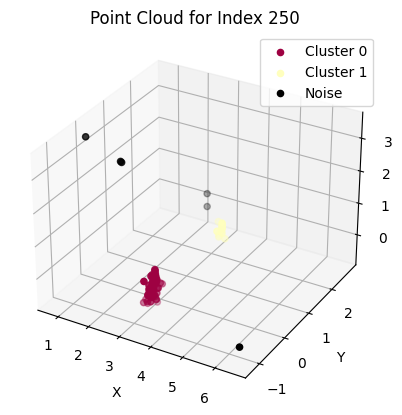

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


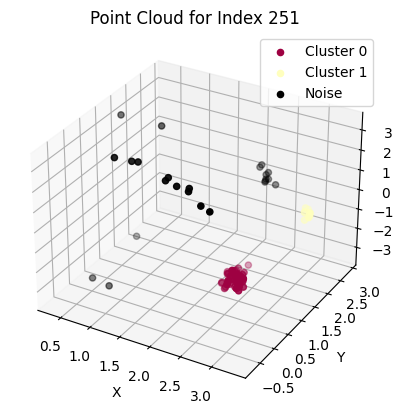

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


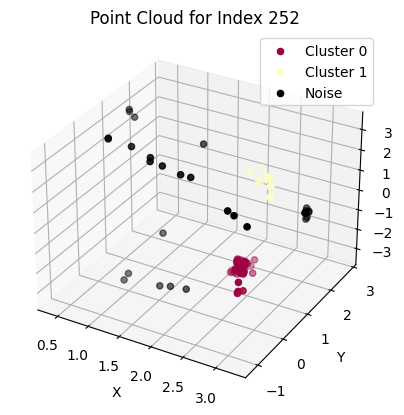

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


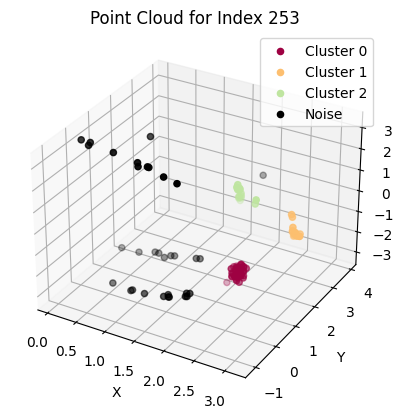

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


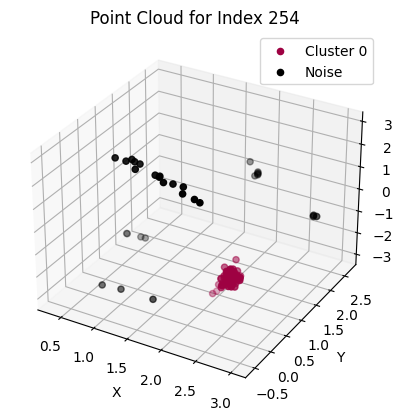

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


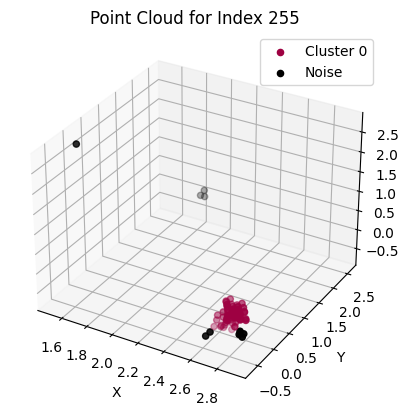

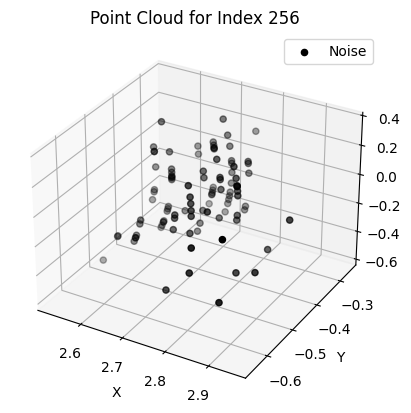

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


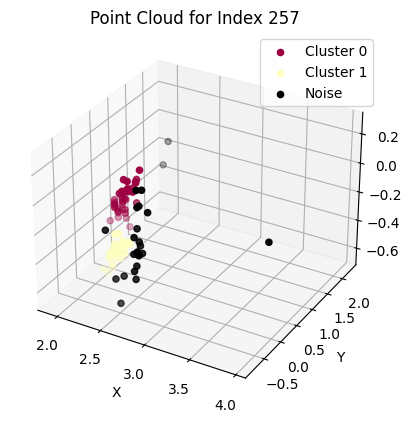

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


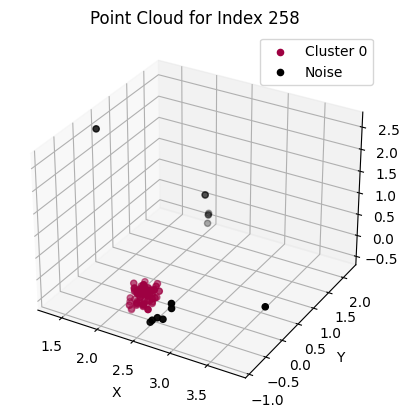

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


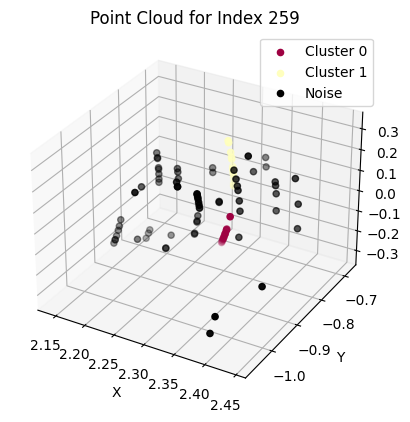

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


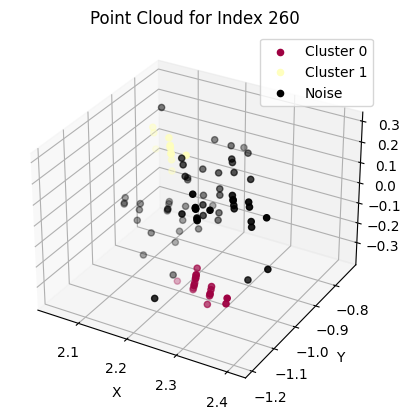

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


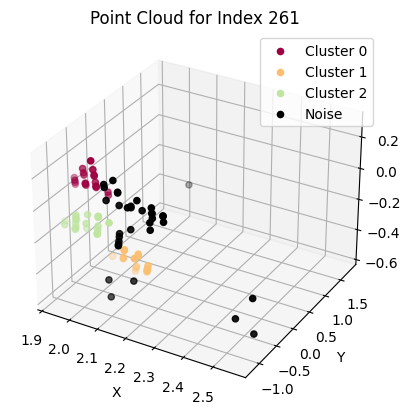

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


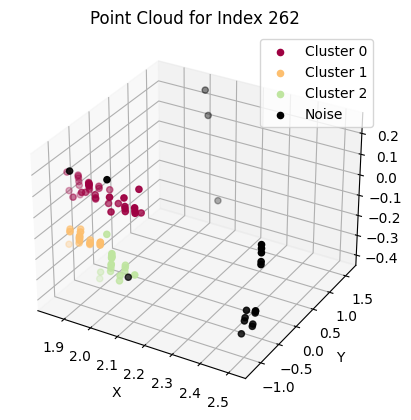

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


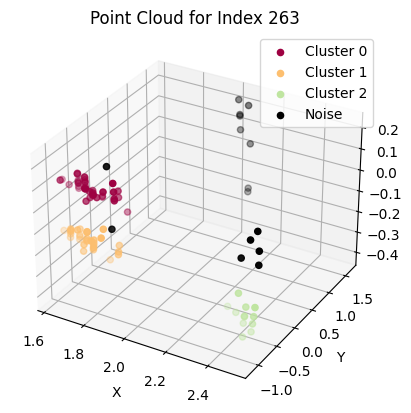

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


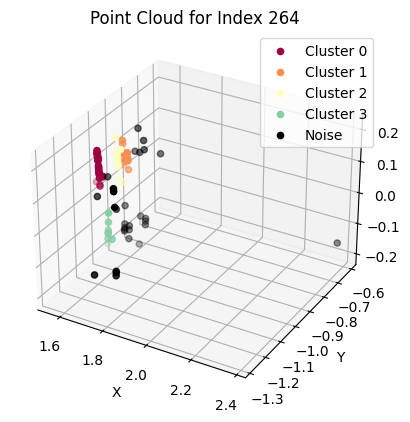

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


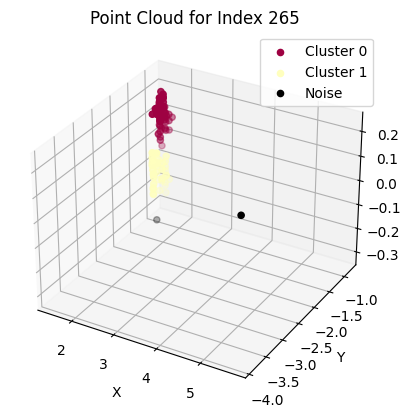

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


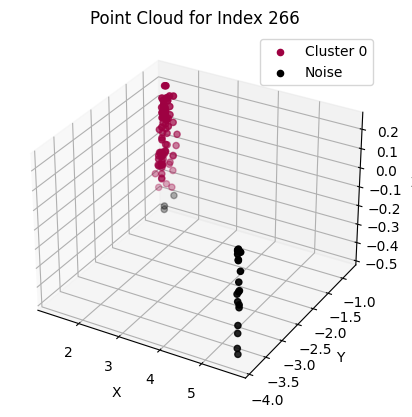

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


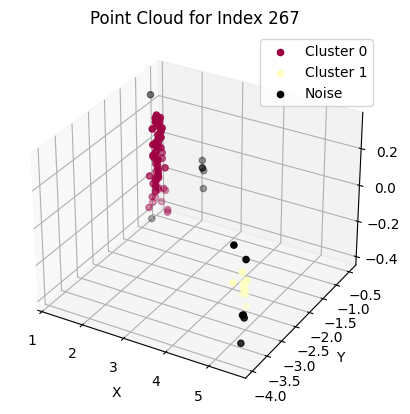

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


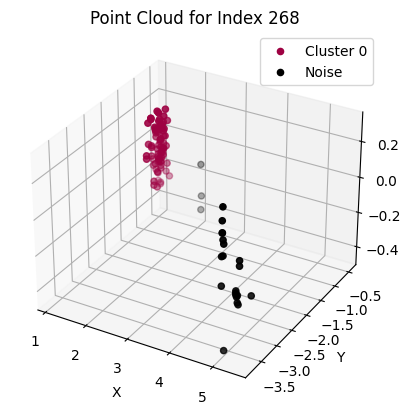

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


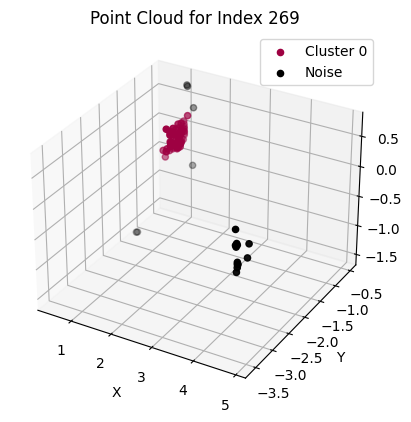

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


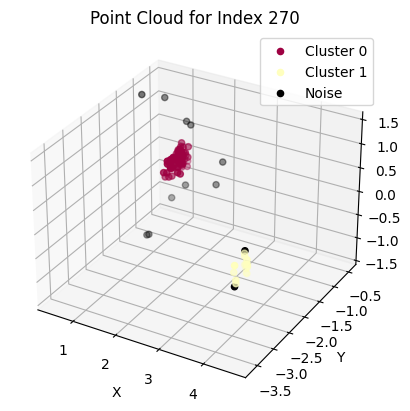

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


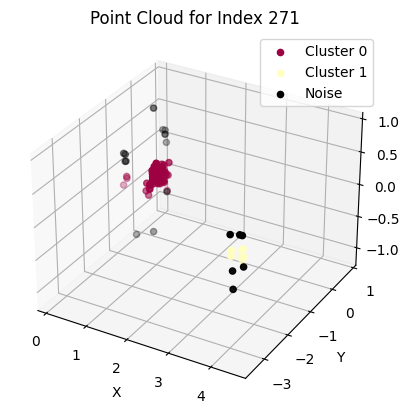

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


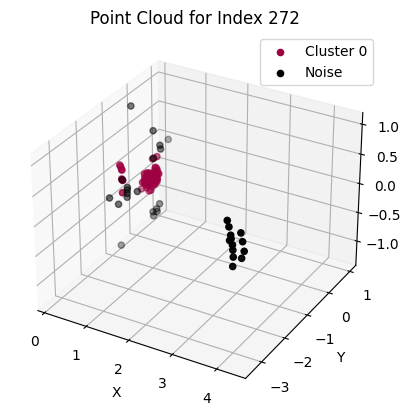

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


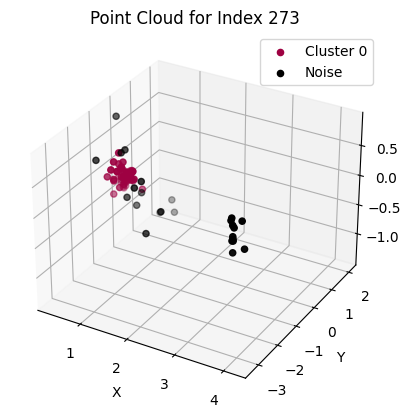

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


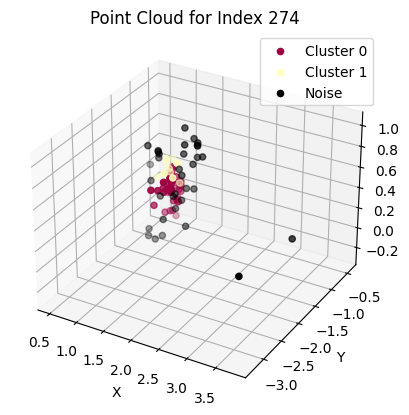

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


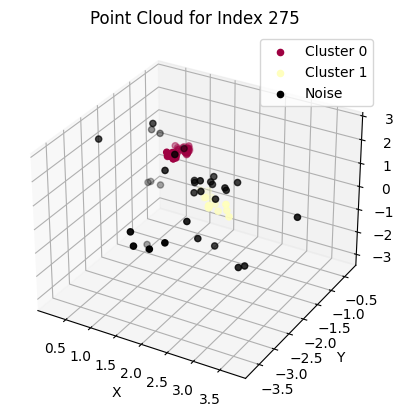

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


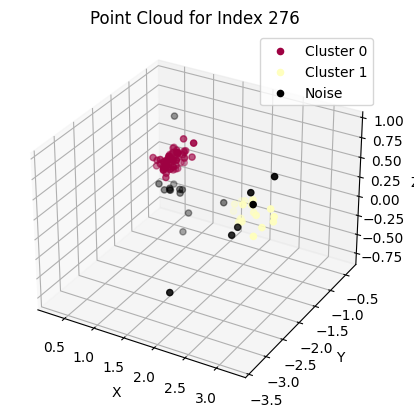

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


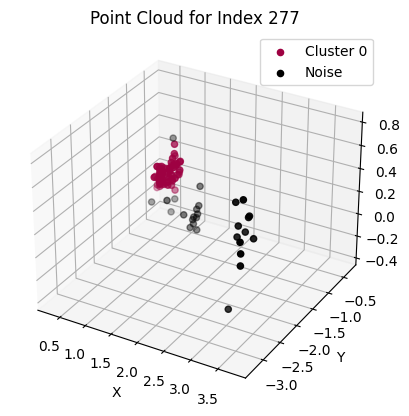

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


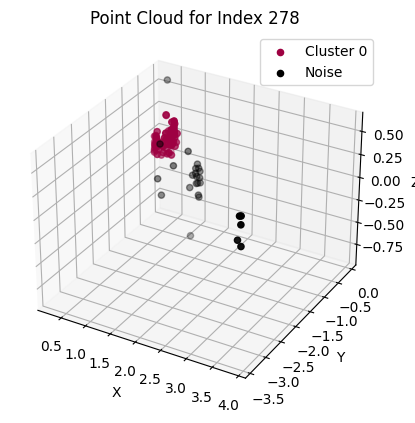

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


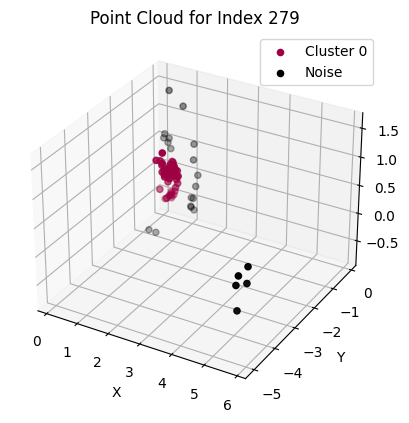

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


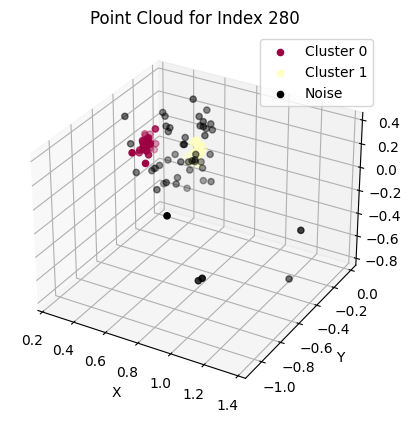

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


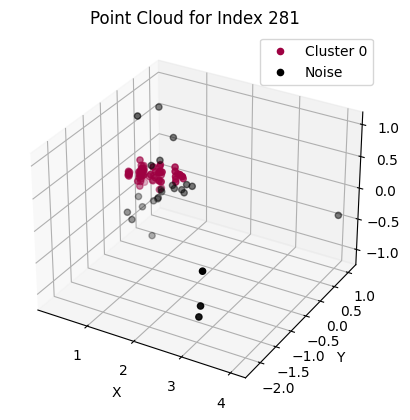

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


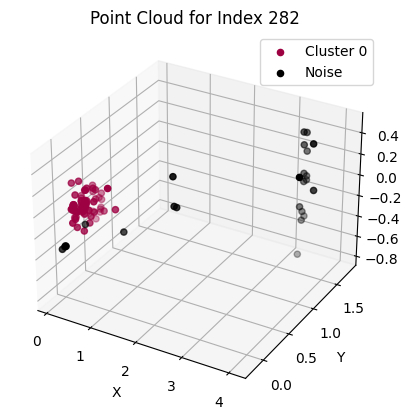

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


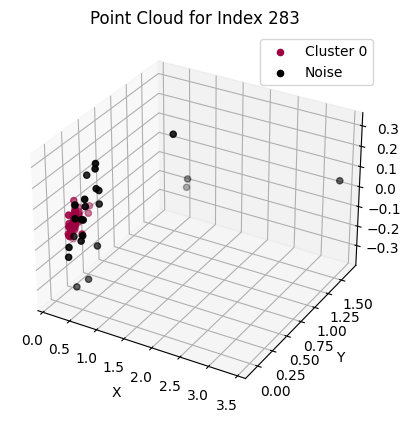

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


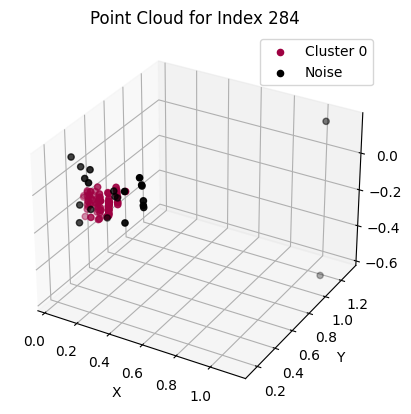

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


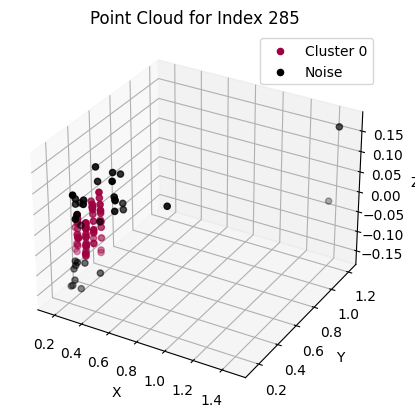

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


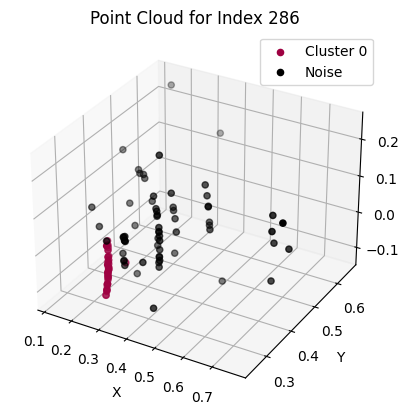

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


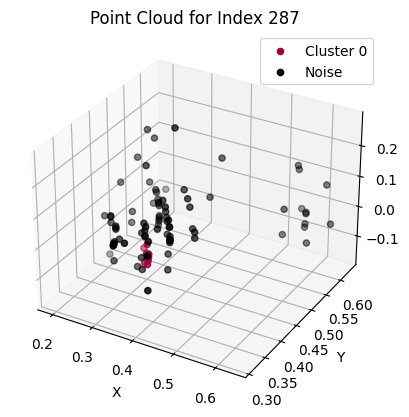

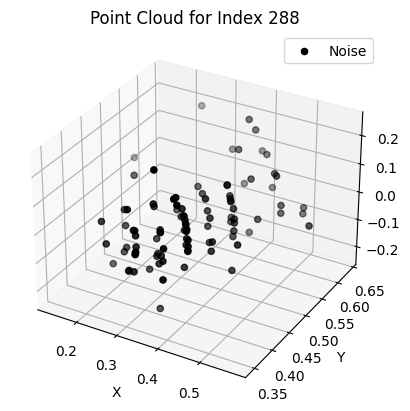

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


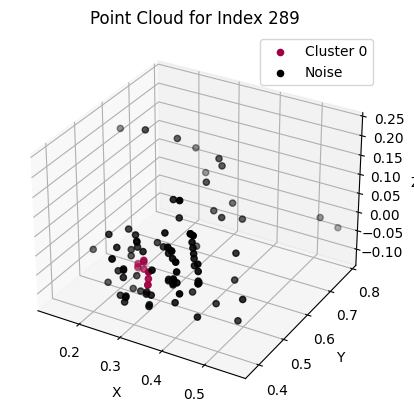

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


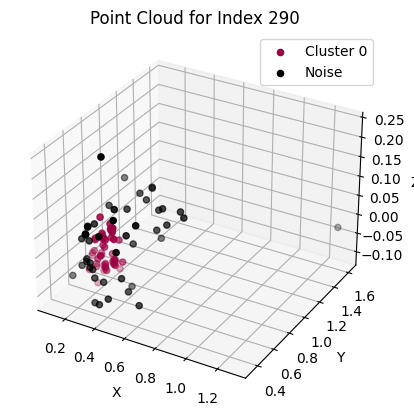

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


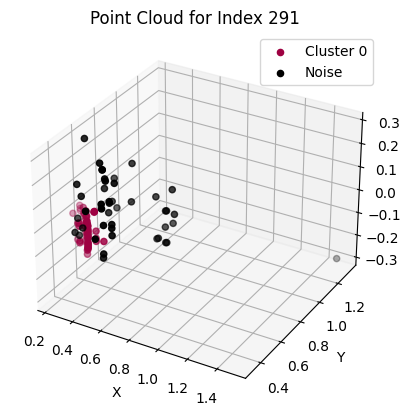

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


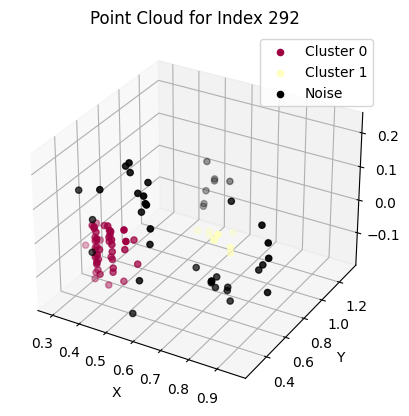

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


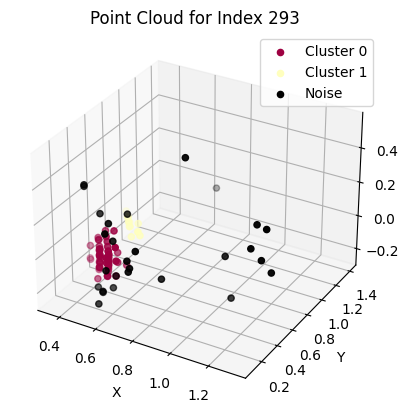

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


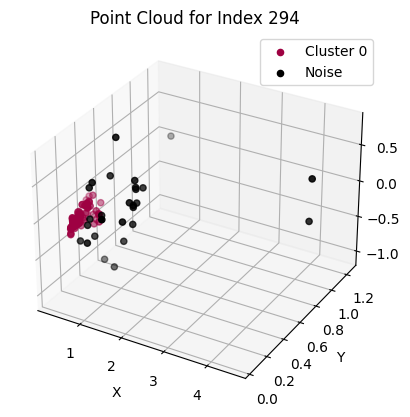

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


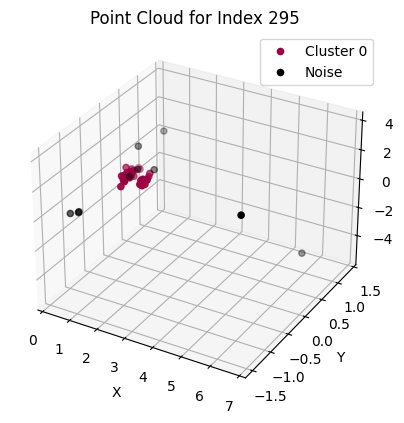

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


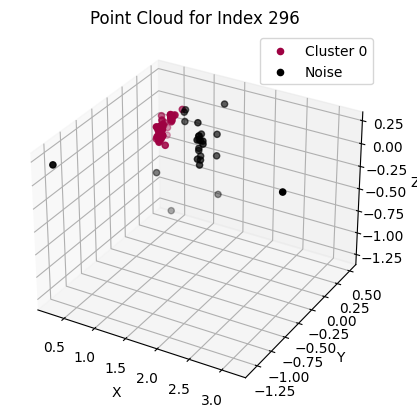

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


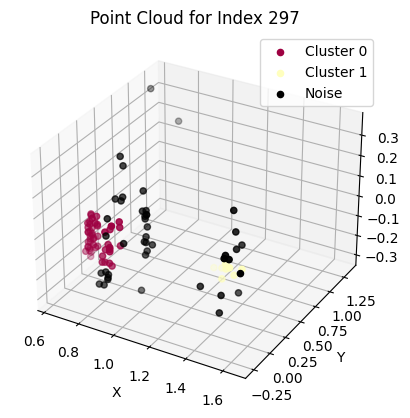

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


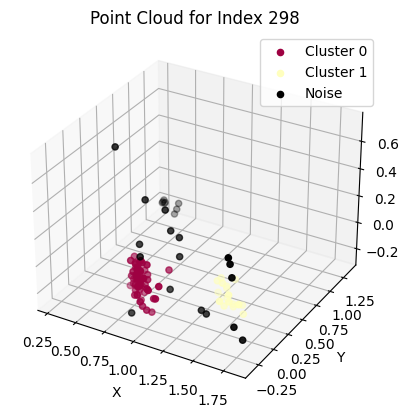

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


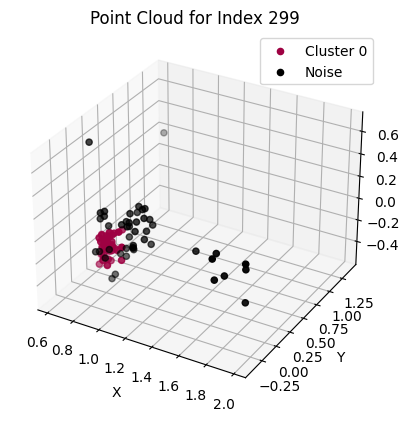

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


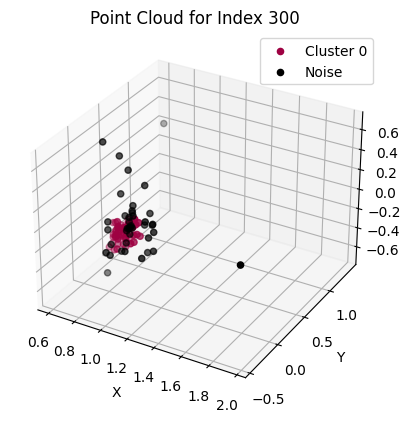

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


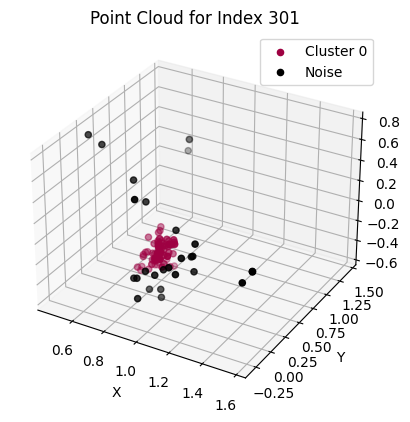

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


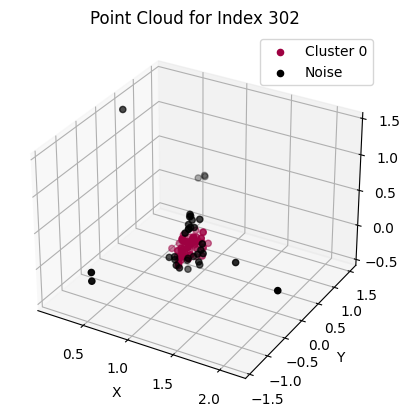

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


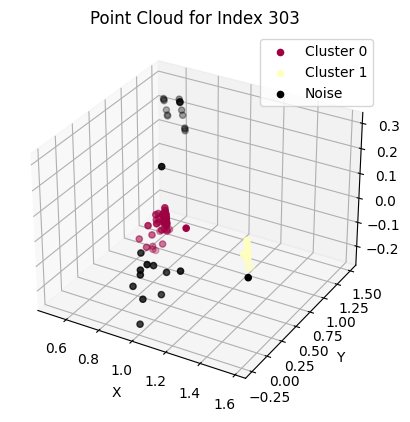

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


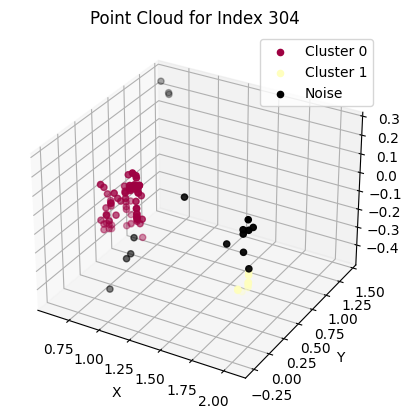

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


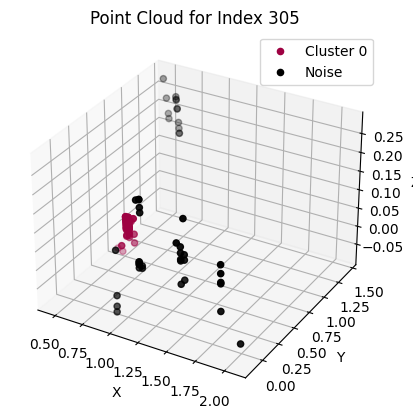

<ipython-input-28-e4a937c94fab>:77: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')


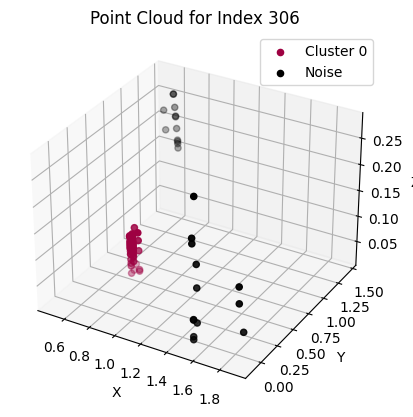

IndexError: ignored

In [28]:
# import pandas as pd
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D
# import numpy as np


# # Create a 3D scatter plot for point clouds at indices 1 to 10
# for index in range(1, 30):
#     fig = plt.figure()
#     ax = fig.add_subplot(111, projection='3d')

#     # Extract and split the point cloud data
#     point_cloud_data = df.iloc[index]['FileContent'].strip().split('\n')
#     point_cloud = np.array([list(map(float, point.split())) for point in point_cloud_data if point])

#     # Scatter plot using x, y, z coordinates, color by cluster label
#     ax.scatter(point_cloud[:, 0], point_cloud[:, 1], point_cloud[:, 2], label='Cluster {}'.format(df.iloc[index]['cluster']))

#     # Convert the list of points into a numpy array
#     X = np.array(point_cloud)
#     X2= StandardScaler().fit_transform(X)
#     # Now you can run DBSCAN
#     dbscan_cluster_model = DBSCAN(eps=0.25, min_samples=15).fit(X2)
#     print(dbscan_cluster_model)
#     # Set labels and title
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.set_zlabel('Z')
#     ax.set_title('Point Cloud Index: {}'.format(index))

#     # Show plot with legend
#     ax.legend()
#     plt.show()


from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Load the CSV file into a pandas DataFrame

# Define the range of indices for point clouds you want to visualize
start_index = 1
end_index = 306

for index in range(start_index, end_index + 1):
    # Extract the point cloud data for the current index
    point_cloud_data = df.iloc[index - 1]['FileContent'].strip().split('\n')
    point_cloud = np.array([np.fromstring(point, sep=' ') for point in point_cloud_data if point])

    # Standardize the point cloud data
    point_cloud_normalized = StandardScaler().fit_transform(point_cloud)

    # Perform DBSCAN clustering
    clustering = DBSCAN(eps=0.5, min_samples=10).fit(point_cloud_normalized)
    labels = clustering.labels_

    # Create a new figure for 3D plotting
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Plot the points with different colors for each cluster
    unique_labels = set(labels)
    colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))

    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Black used for noise.
            col = 'k'

        class_member_mask = (labels == k)

        xyz = point_cloud[class_member_mask]
        ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, label=f'Cluster {k}' if k != -1 else 'Noise')

    # Label the axes
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(f'Point Cloud for Index {index}')
    ax.legend()

    # Show the plot
    plt.show()



### Box

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


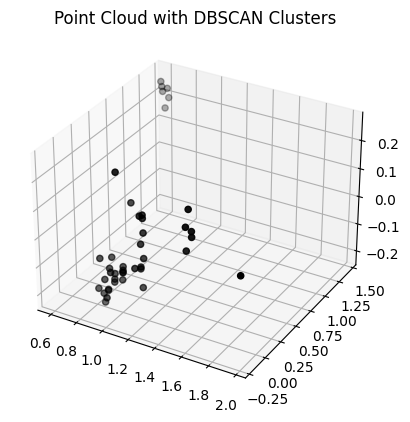

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


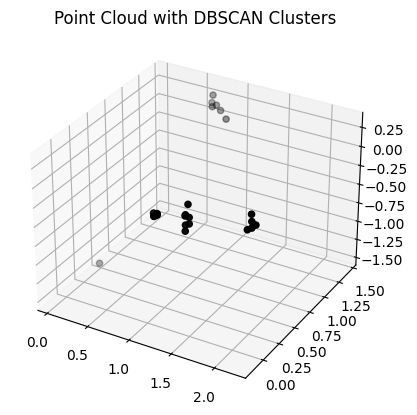

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


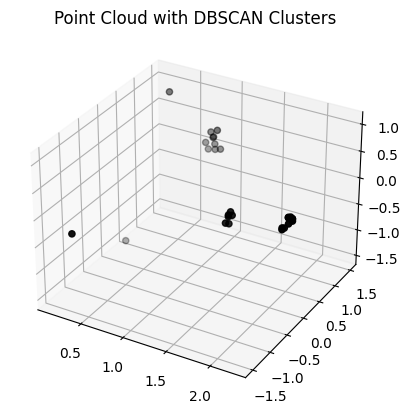

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


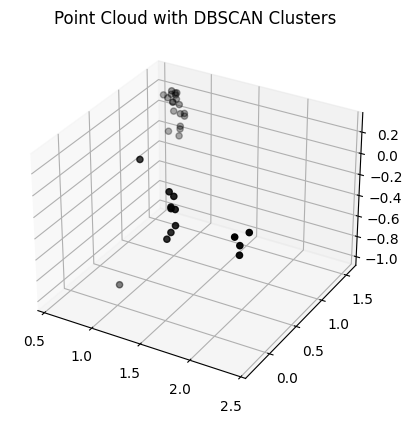

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


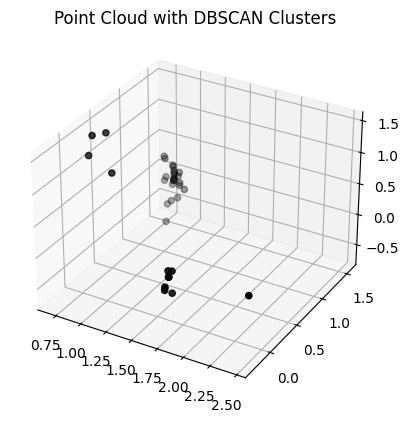

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


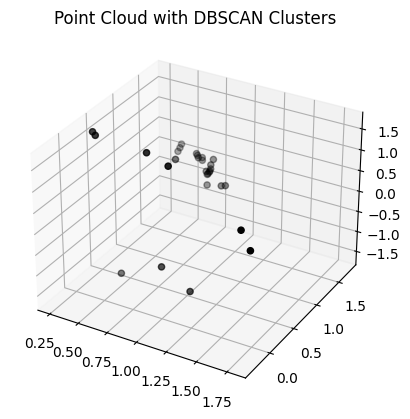

<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


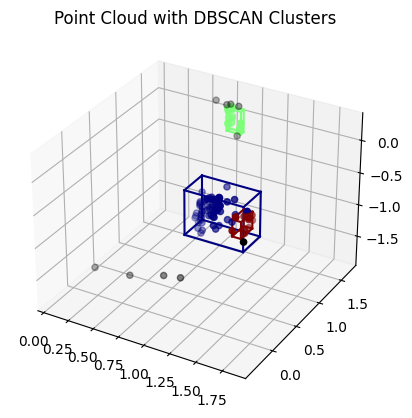

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


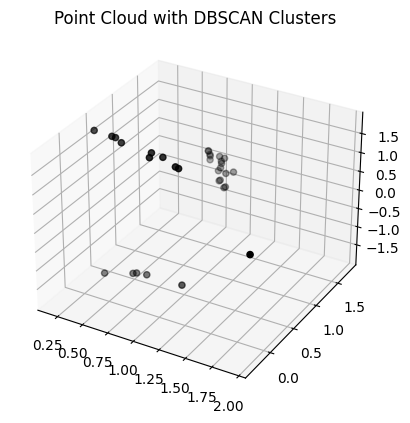

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


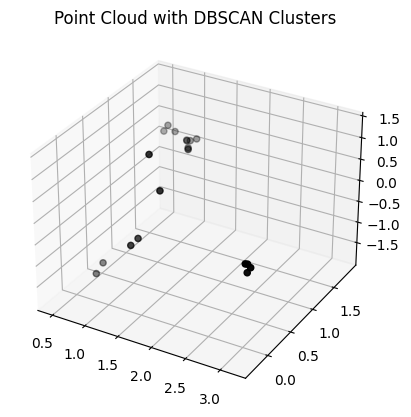

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


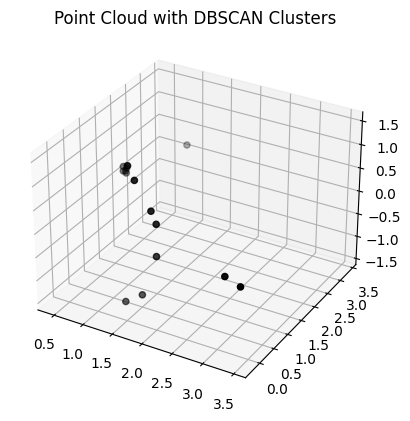

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


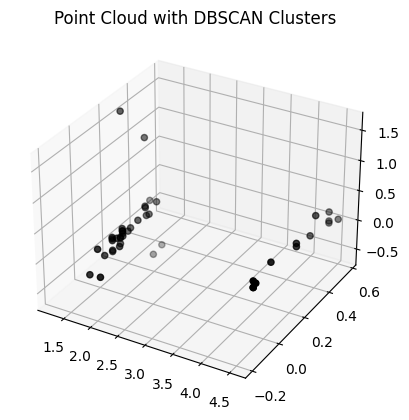

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


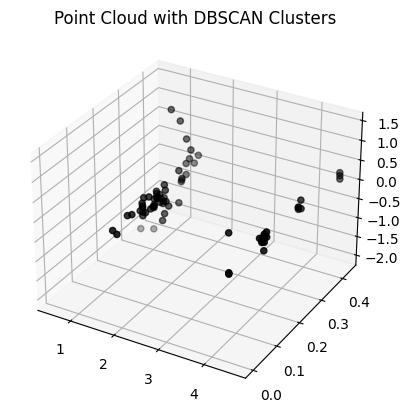

<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


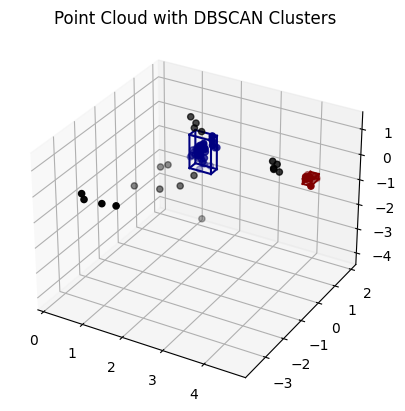

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


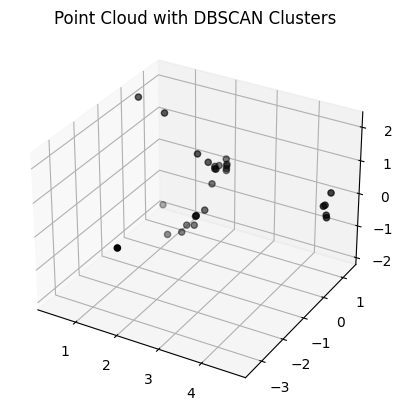

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


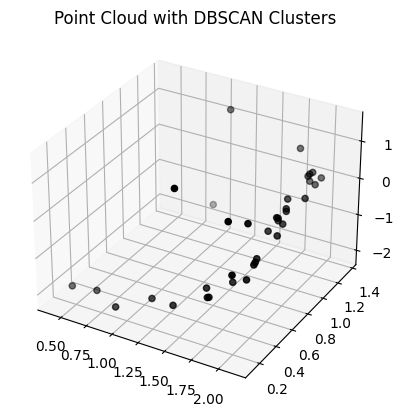

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


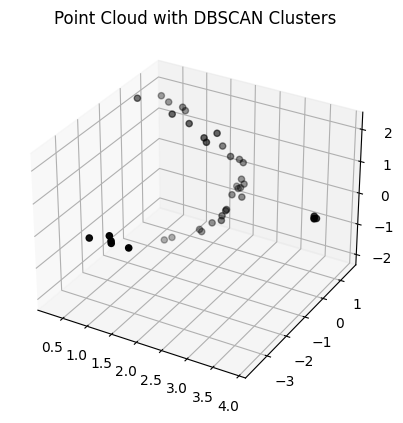

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


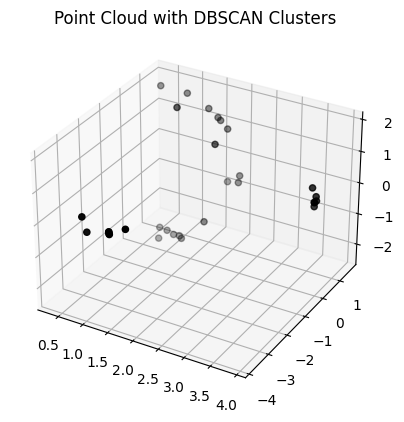

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


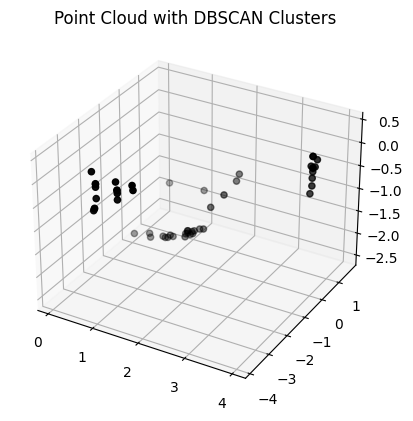

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


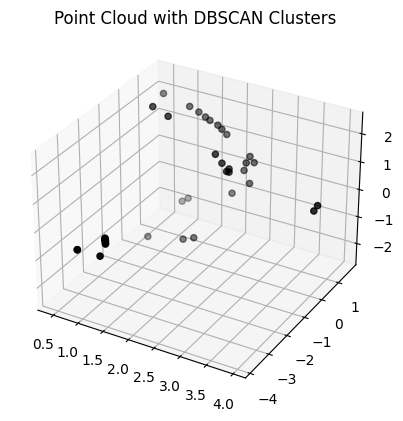

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


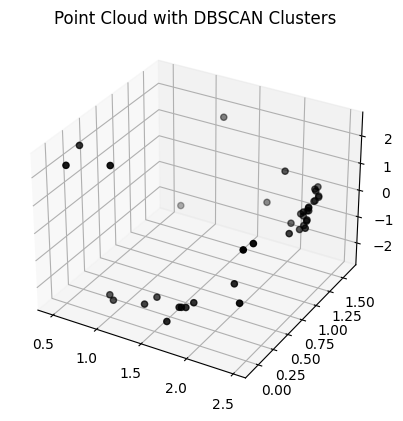

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


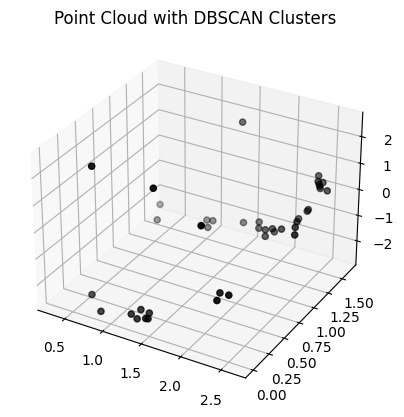

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


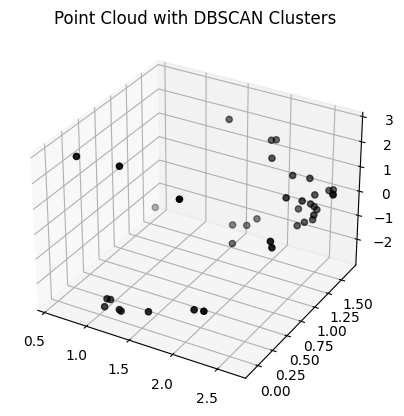

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


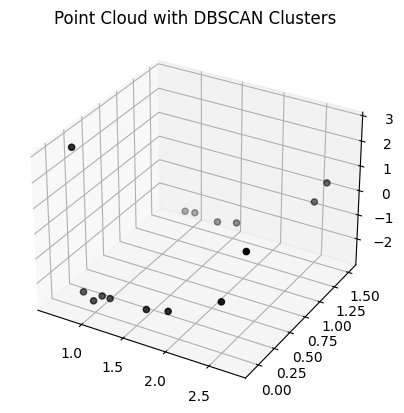

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


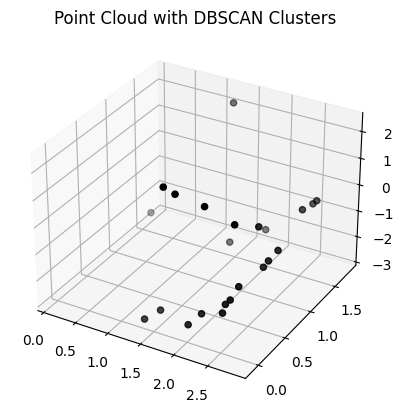

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


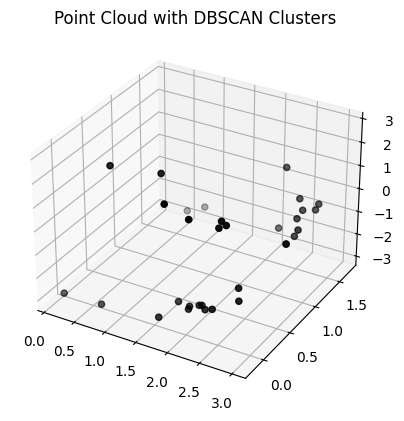

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


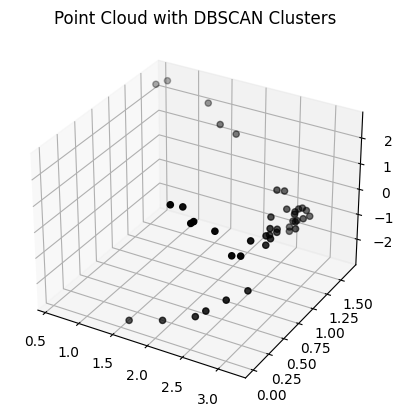

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


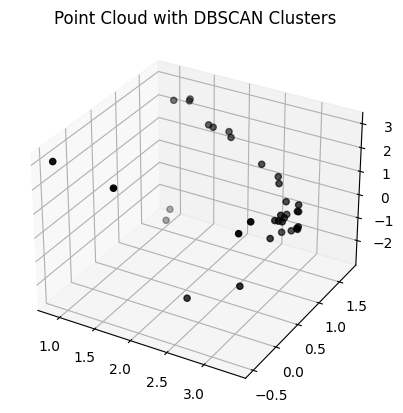

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


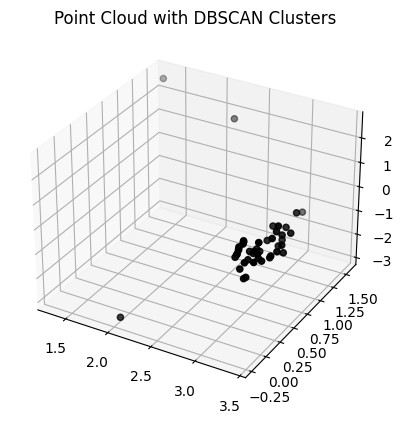

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


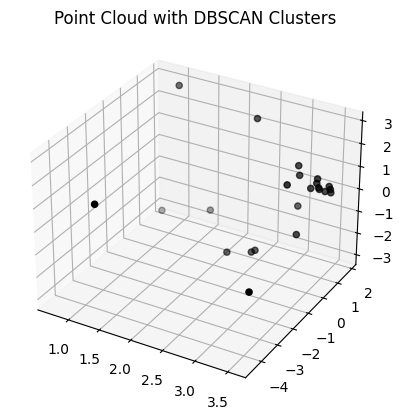

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


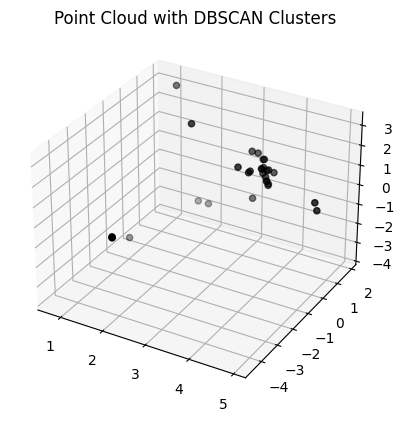

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


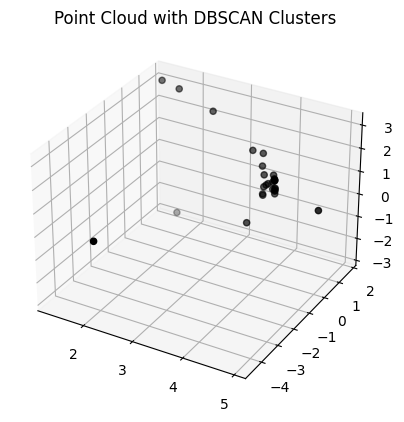

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


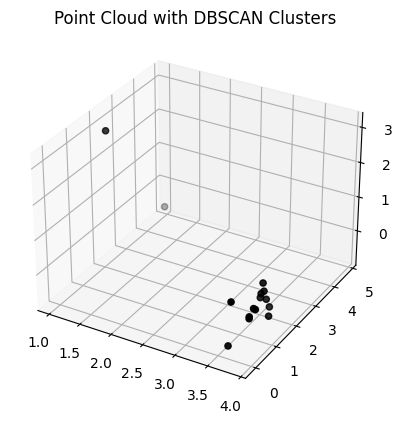

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


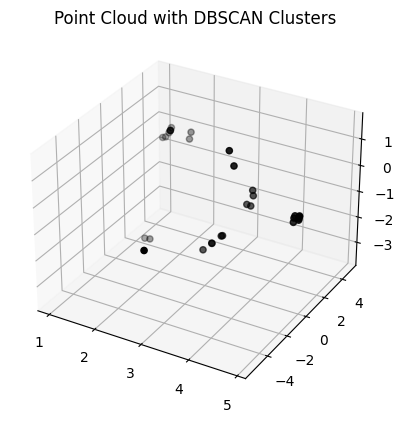

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


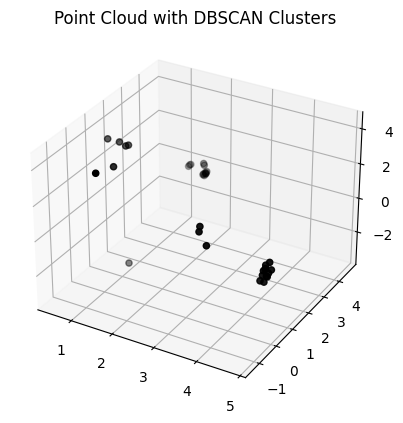

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


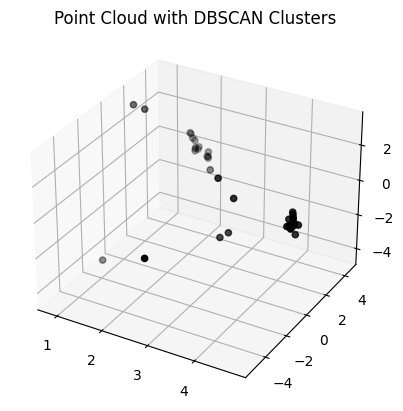

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


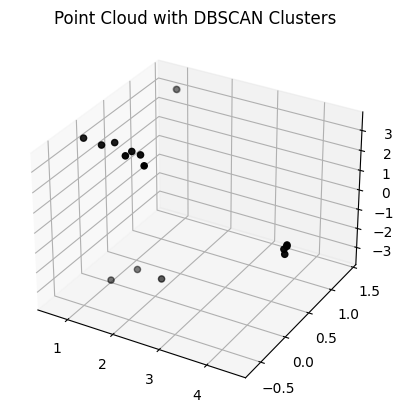

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


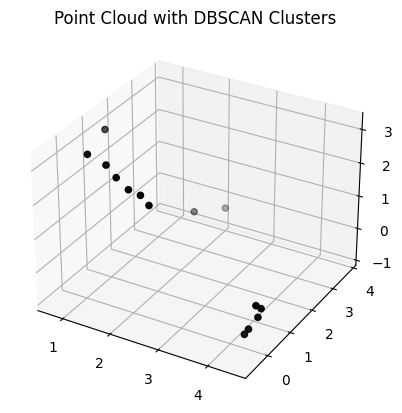

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


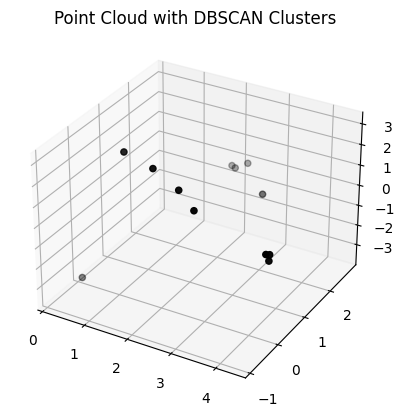

<ipython-input-87-4adc9de605d2>:51: RuntimeWarning: invalid value encountered in divide
  color = plt.cm.jet(float(label) / max(unique_labels))
<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


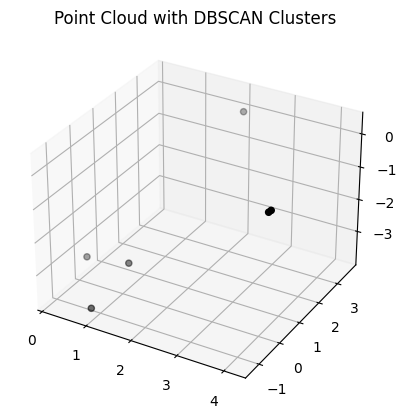

<ipython-input-87-4adc9de605d2>:54: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)


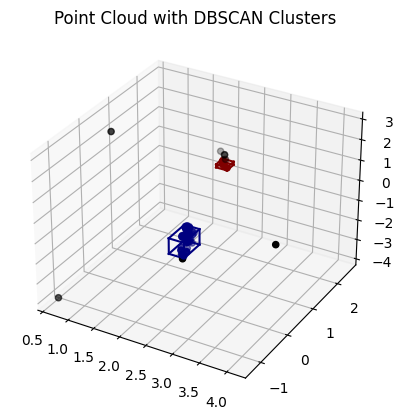

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Function to draw a bounding box around a cluster
def draw_bounding_box(ax, points, color='red'):
    x_min, x_max = np.min(points[:, 0]), np.max(points[:, 0])
    y_min, y_max = np.min(points[:, 1]), np.max(points[:, 1])
    z_min, z_max = np.min(points[:, 2]), np.max(points[:, 2])
    corners = [
        [x_min, y_min, z_min],
        [x_min, y_min, z_max],
        [x_min, y_max, z_min],
        [x_min, y_max, z_max],
        [x_max, y_min, z_min],
        [x_max, y_min, z_max],
        [x_max, y_max, z_min],
        [x_max, y_max, z_max]
    ]
    lines = [
        [0, 1], [1, 3], [3, 2], [2, 0], # bottom
        [4, 5], [5, 7], [7, 6], [6, 4], # top
        [0, 4], [1, 5], [2, 6], [3, 7]  # sides
    ]
    for line in lines:
        ax.plot([corners[line[0]][0], corners[line[1]][0]],
                [corners[line[0]][1], corners[line[1]][1]],
                [corners[line[0]][2], corners[line[1]][2]], c=color)

# Iterate over the DataFrame rows and plot each point cloud with its DBSCAN cluster bounding boxes
for index in range(1, 41):
    row = df.iloc[index]
    point_cloud = np.array([list(map(float, point.split())) for point in row['FileContent'].strip().split('\n')])
    # Standardize the data
    X_std = StandardScaler().fit_transform(point_cloud)
    # Run DBSCAN
    db = DBSCAN(eps=0.5, min_samples=15).fit(X_std)
    labels = db.labels_
    unique_labels = set(labels)
    # Create a 3D scatter plot
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    for label in unique_labels:
        if label == -1:  # Noise
            color = 'k'
        else:
            color = plt.cm.jet(float(label) / max(unique_labels))
        class_member_mask = (labels == label)
        xyz = point_cloud[class_member_mask]
        ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=color)
        if label != -1:  # Don't draw a box for noise
            draw_bounding_box(ax, xyz, color=color)
    plt.title('Point Cloud with DBSCAN Clusters')
    plt.show()


### DB Scan for one pointcloud


In [ ]:
point_clouds = df['FileContent']
print(point_clouds[0])
# Initialize a list to store all points
all_points = []
values=[]
# Process each point cloud
for cloud_string in point_clouds:
    # print(cloud_string)
    # Split the string into lines, each line is a point
    points = cloud_string.split('\n')
    for po in points:
      point_value=po.split(' ')
      point_floats = [float(value) for value in point_value]
      # print(point_floats)
    all_points.append(list(map(float, point_floats)))
    X1 = np.array([point_floats])
    X1= StandardScaler().fit_transform(X1)
    best_dict = get_scores_and_labels(combinations, X1)
    values.append(best_dict)
    break
# print(all_points)


3.455026149749756 0.10851676762104034 -0.33095046877861023
3.3510031700134277 1.1813218593597412 1.290501356124878
4.9572906494140625 0.31044039130210876 0.021110380068421364
2.399639368057251 -4.346165657043457 0.1553173065185547
3.349372148513794 0.10851676762104034 -0.9101865291595459
3.385883092880249 0.22252807021141052 -1.0784592628479004
1.531172513961792 1.6689605712890625 2.7471585273742676
3.465153217315674 0.10851676762104034 -0.1986134797334671
3.078867197036743 1.4340696334838867 1.7573896646499634
2.0905582904815674 -4.501385688781738 0.19657135009765625
4.944768905639648 0.46566057205200195 -0.06302335858345032
3.4739139080047607 0.1098904013633728 -0.5343862175941467
3.4694478511810303 0.10851676762104034 -0.0983150452375412
3.6012628078460693 0.5700564384460449 0.12838077545166016
3.4265658855438232 0.10851676762104034 -0.5526117086410522
3.4651689529418945 0.2170335352420807 -0.06332463026046753
3.6031687259674072 0.5700564384460449 -0.05244549736380577
3.321612358093

In [ ]:
print(values)

[{'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_min_samples': 2, 'best_labels': 'bad', 'best_score': -10}, {'best_epsilon': 0.01, 'best_mi

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Convert the list of points into a numpy array
X = np.array(all_points)
X2= StandardScaler().fit_transform(X)
# Now you can run DBSCAN
dbscan_cluster_model = DBSCAN(eps=0.2, min_samples=15).fit(X2)
dbscan_cluster_model

DBSCAN(eps=0.2, min_samples=15)

In [ ]:
def get_scores_and_labels(combinations, X):
  scores = []
  all_labels_list = []

  for i, (eps, num_samples) in enumerate(combinations):
    dbscan_cluster_model = DBSCAN(eps=eps, min_samples=num_samples).fit(X)
    labels = dbscan_cluster_model.labels_
    labels_set = set(labels)
    num_clusters = len(labels_set)
    if -1 in labels_set:
      num_clusters -= 1

    if (num_clusters < 1) or (num_clusters > 3):
      scores.append(-10)
      all_labels_list.append('bad')
      c = (eps, num_samples)
      # print(f"Combination {c} on iteration {i+1} of {N} has {num_clusters} clusters. Moving on")
      continue

    scores.append(ss(X, labels))
    all_labels_list.append(labels)
    print(f"Index: {i}, Score: {scores[-1]}, Labels: {all_labels_list[-1]}, NumClusters: {num_clusters}")

  best_index = np.argmax(scores)
  best_parameters = combinations[best_index]
  best_labels = all_labels_list[best_index]
  best_score = scores[best_index]

  return {'best_epsilon': best_parameters[0],
          'best_min_samples': best_parameters[1],
          'best_labels': best_labels,
          'best_score': best_score}



### Rest

In [ ]:
fig = px.scatter(x=longg, y=lat, color=df['cluster'])
fig.show()

In [ ]:
df

In [ ]:
plt.scatter(df.total_rooms, df.housing_median_age)

In [ ]:
X2 = df[['total_rooms', 'housing_median_age']].to_numpy()
X2

In [ ]:
best_dict_2 = get_scores_and_labels(combinations, X2)

In [ ]:
best_dict_2

In [ ]:
from sklearn.preprocessing import StandardScaler

X2_scaled = StandardScaler().fit_transform(X2)

plt.scatter(X2_scaled[:, 0], X2_scaled[:, 1])

In [ ]:
best_dict_3 = get_scores_and_labels(combinations, X2_scaled)


Combination (0.01, 2) on iteration 1 of 90 has 1884 clusters. Moving on
Combination (0.01, 5) on iteration 2 of 90 has 685 clusters. Moving on
Combination (0.01, 8) on iteration 3 of 90 has 337 clusters. Moving on
Combination (0.01, 11) on iteration 4 of 90 has 133 clusters. Moving on
Combination (0.01, 14) on iteration 5 of 90 has 60 clusters. Moving on
Index: 5, Score: -0.5312324216453211, Labels: [-1 -1 -1 ... -1 -1 11], NumClusters: 32
Combination (0.08071428571428571, 2) on iteration 7 of 90 has 99 clusters. Moving on
Index: 7, Score: -0.20384053173649058, Labels: [ 0 -1  0 ...  0  0  0], NumClusters: 34
Index: 8, Score: -0.1828630389511955, Labels: [ 0 -1  0 ...  0  0  0], NumClusters: 23
Index: 9, Score: -0.22366221116925375, Labels: [ 0 -1  0 ...  0  0  0], NumClusters: 23
Index: 10, Score: -0.23893089977584267, Labels: [ 0 -1  1 ...  1  1  1], NumClusters: 10
Index: 11, Score: -0.1439507321917493, Labels: [-1 -1  0 ...  0  0  0], NumClusters: 7
Index: 12, Score: 0.170115222274

In [ ]:
best_dict_3

{'best_epsilon': 0.8585714285714285,
 'best_labels': array([0, 0, 0, ..., 0, 0, 0]),
 'best_min_samples': 2,
 'best_score': 0.8739122955987667}

In [ ]:
fig = px.scatter(x=X2_scaled[:, 0], y=X2_scaled[:, 1], color=best_dict_3['best_labels'])
fig.show()